# Import and set colors

In [1]:
import scanpy as sc
import anndata as ann
import numpy as np
import scipy as sp
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import cm, colors
from gprofiler import gprofiler

import os 

#pretty plotting
import seaborn as sb


In [2]:
#Define a nice colour map for gene expression
colors2 = plt.cm.plasma(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,20))
colorsComb = np.vstack([colors3, colors2])
mymap2 = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

In [3]:
plt.rcParams['figure.figsize']=(5,5) #rescale figures
sc.settings.verbosity = 3
sc.set_figure_params(scanpy=True, dpi=100, dpi_save=300,transparent=True, fontsize=14, color_map=mymap2)
sc.logging.print_header()

scanpy==1.7.1 anndata==0.7.5 umap==0.5.1 numpy==1.22.3 scipy==1.8.0 pandas==1.2.3 scikit-learn==0.24.1 statsmodels==0.12.2 python-igraph==0.8.3 louvain==0.7.0 leidenalg==0.8.3 pynndescent==0.5.4


# Set project file paths

In [4]:
file_path = '/Volumes/Seagate_Exp/Paper_sc_analysis/notebooks/analysis_early_time_points/040522_corrected_notebooks/Revision/'
#this is my file path please adapt it to your directory

In [5]:
data_dir =file_path +  'data/' 

In [6]:
table_dir = file_path + 'tables/'

In [7]:
sc.settings.figdir = file_path + 'figures/5b_treated/'

In [8]:
import datetime

today = datetime.date.today().strftime('%y%m%d') #creates a YYMMDD string of today's date

# Astrocytes 

## Read Data & downstream analysis

In [9]:
adata_all_astros_proc = sc.read(data_dir + '230807adata_all_astros_treated_scVI.h5ad')

In [10]:
adata_all_astros_proc.obs['annotated'].value_counts()

0_Astrocytes     7644
4_Astrocytes     4189
8_Astrocytes     2144
11_Astrocytes    2048
Name: annotated, dtype: int64

In [11]:
#Filter genes:
print('Total number of genes: {:d}'.format(adata_all_astros_proc.n_vars))

# Min 20 cells - filters out 0 count genes
sc.pp.filter_genes(adata_all_astros_proc, min_cells=20)
print('Number of genes after cell filter: {:d}'.format(adata_all_astros_proc.n_vars))

Total number of genes: 19290
filtered out 3543 genes that are detected in less than 20 cells
Number of genes after cell filter: 15747


In [12]:
# use scVI latent space for UMAP generation
sc.pp.neighbors(adata_all_astros_proc, use_rep="X_scVI")

computing neighbors


OMP: Info #271: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:06)


In [13]:
sc.tl.umap(adata_all_astros_proc)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:07)


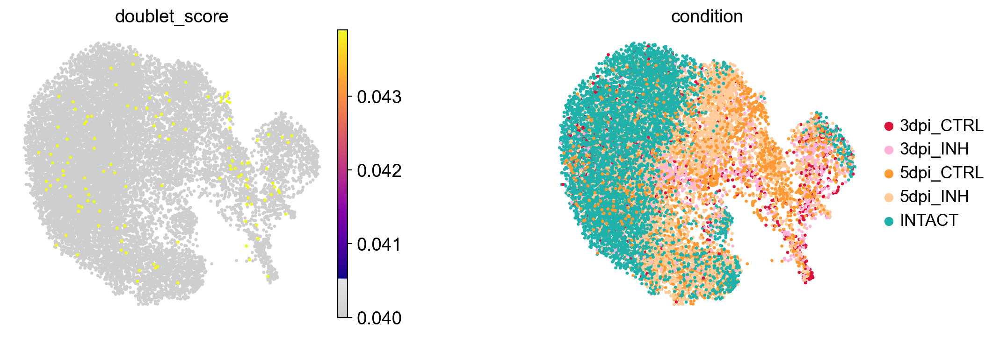

In [14]:
sc.pl.umap(adata_all_astros_proc, color=['doublet_score', 'condition'], frameon=False, wspace=0.5,cmap=mymap2, size=24, vmin=0.04)

In [15]:
set(adata_all_astros_proc.obs['condition'])

{'3dpi_CTRL', '3dpi_INH', '5dpi_CTRL', '5dpi_INH', 'INTACT'}

In [16]:
adata_all_astros_proc

AnnData object with n_obs × n_vars = 16025 × 15747
    obs: 'sample_id', 'condition', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'n_counts', 'n_genes', 'doublet_score', 'doublet', 'size_factors', 'leiden', '_scvi_batch', '_scvi_labels', 'leiden_scVI', 'leiden13', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'leiden_all', 'S_score', 'G2M_score', 'phase', 'Cycling cells', 'cell_cycle', 'Microglia', 'DAM', 'Macrophages', 'BAM', 'Monocytes', 'DCs', 'NKT cells', 'T cells', 'B cells', 'Neutrophils', 'Neurons', 'OPCs', 'COPs', 'MOL', 'Astrocytes', 'Pericytes', 'VSMCs', 'VLMCs', 'VEC', 'annotated', 'annotated_group'
    var: 'gene_ids', 'feature_types', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_coun

In [17]:
sc.tl.leiden(adata_all_astros_proc, key_added='leiden_astros_r1')
sc.tl.leiden(adata_all_astros_proc, resolution=0.5, key_added='leiden_astros_r0.5')
sc.tl.leiden(adata_all_astros_proc, resolution=0.4, key_added='leiden_astros_r0.4')
sc.tl.leiden(adata_all_astros_proc, resolution=0.6, key_added='leiden_astros_r0.6')

running Leiden clustering
    finished: found 15 clusters and added
    'leiden_astros_r1', the cluster labels (adata.obs, categorical) (0:00:02)
running Leiden clustering
    finished: found 8 clusters and added
    'leiden_astros_r0.5', the cluster labels (adata.obs, categorical) (0:00:02)
running Leiden clustering
    finished: found 7 clusters and added
    'leiden_astros_r0.4', the cluster labels (adata.obs, categorical) (0:00:02)
running Leiden clustering
    finished: found 8 clusters and added
    'leiden_astros_r0.6', the cluster labels (adata.obs, categorical) (0:00:02)


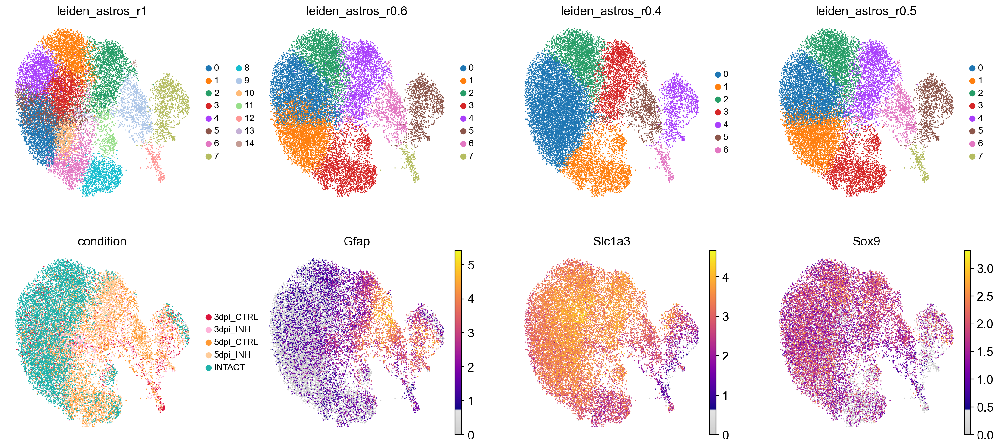

In [18]:
sc.pl.umap(adata_all_astros_proc, color=['leiden_astros_r1','leiden_astros_r0.6','leiden_astros_r0.4', 'leiden_astros_r0.5','condition','Gfap', 'Slc1a3','Sox9'], legend_fontsize =float(10),
        legend_fontweight= 'normal', frameon= False,cmap=mymap2  )

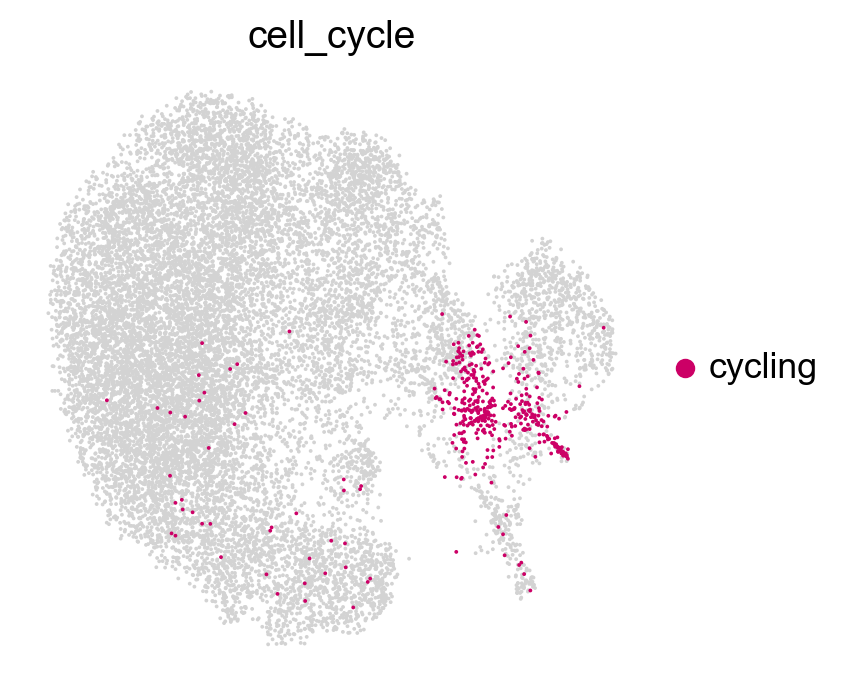

In [19]:
sc.pl.umap(adata_all_astros_proc, color=['cell_cycle'], groups=['cycling'], na_in_legend=False, cmap=mymap2, frameon= False, )#save='_astros_g2m_all.pdf')

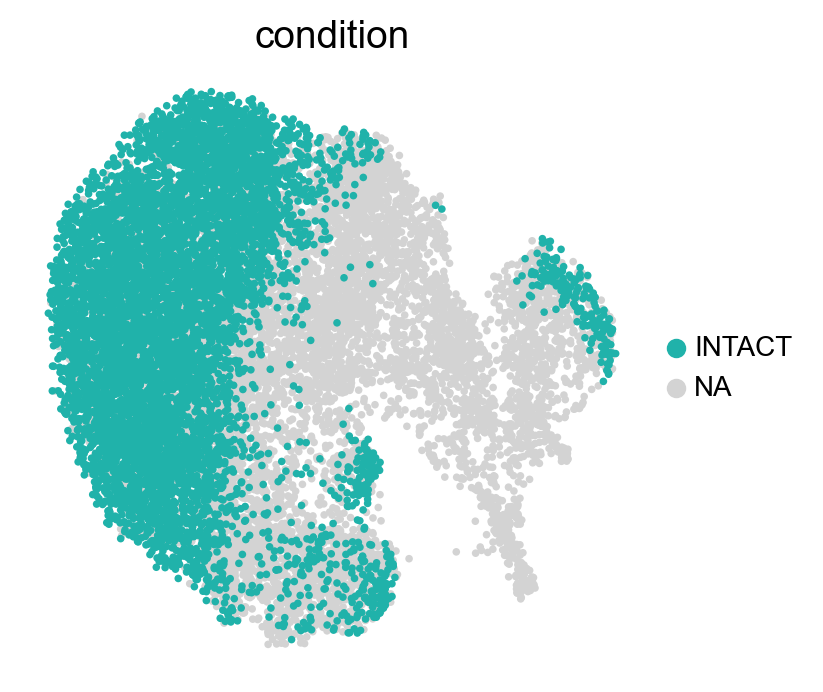

In [20]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all_astros_proc, color=['condition'], legend_fontsize =float(10), size=30, legend_fontweight= 'normal', groups='INTACT', frameon= False )

In [21]:
sc.tl.rank_genes_groups(adata_all_astros_proc, groupby='leiden_astros_r0.5', key_added='rank_genes_astros_r0.5', method='t-test_overestim_var', use_raw=True)

ranking genes
    finished: added to `.uns['rank_genes_astros_r0.5']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:02)


    using 'X_pca' with n_pcs = 9
Storing dendrogram info using `.uns['dendrogram_leiden_astros_r0.5']`


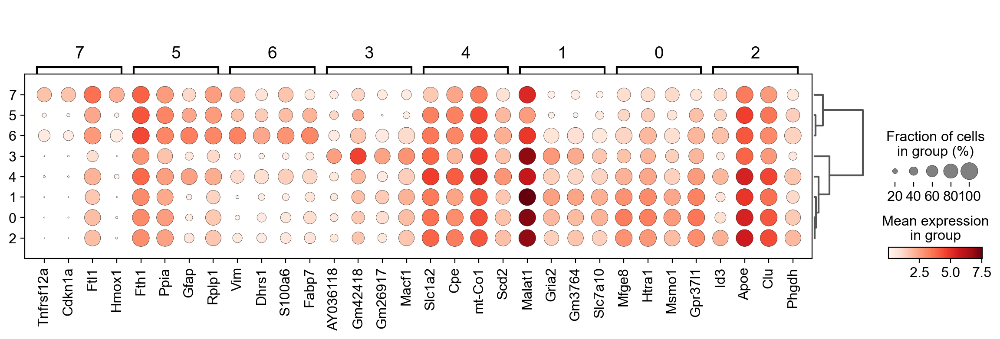

In [22]:
sc.pl.rank_genes_groups_dotplot(adata_all_astros_proc, n_genes=4, key='rank_genes_astros_r0.5')

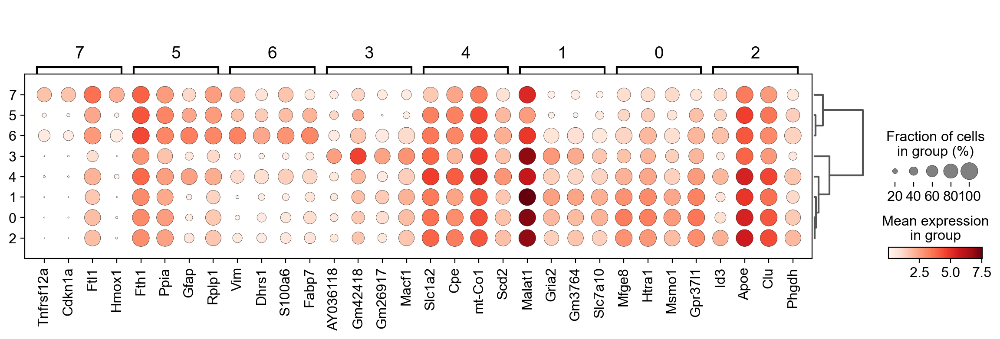

In [23]:
sc.pl.rank_genes_groups_dotplot(adata_all_astros_proc, n_genes=4, key='rank_genes_astros_r0.5')

## Plots for figures

In [24]:
adata_all_astros_proc

AnnData object with n_obs × n_vars = 16025 × 15747
    obs: 'sample_id', 'condition', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'n_counts', 'n_genes', 'doublet_score', 'doublet', 'size_factors', 'leiden', '_scvi_batch', '_scvi_labels', 'leiden_scVI', 'leiden13', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'leiden_all', 'S_score', 'G2M_score', 'phase', 'Cycling cells', 'cell_cycle', 'Microglia', 'DAM', 'Macrophages', 'BAM', 'Monocytes', 'DCs', 'NKT cells', 'T cells', 'B cells', 'Neutrophils', 'Neurons', 'OPCs', 'COPs', 'MOL', 'Astrocytes', 'Pericytes', 'VSMCs', 'VLMCs', 'VEC', 'annotated', 'annotated_group', 'leiden_astros_r1', 'leiden_astros_r0.5', 'leiden_astros_r0.4', 'leiden_astros_r0.6'
    var: 'gene_ids', 'feature

In [25]:
clustersA= ['#4da6ff',# 0
            '#b3d9ff',# 1
            '#4169E1',# 2
            '#bdcbf5',# 3
            '#ff6666',# 4
            '#DC143C',# 5
            '#ffb399',# 6
            '#f48aa0',# 7
           ]

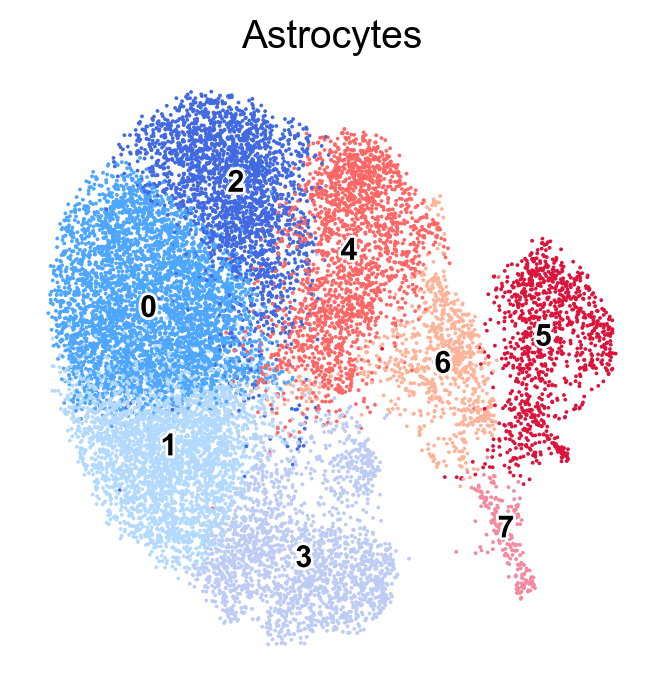

In [26]:
sc.pl.umap(adata_all_astros_proc, color=['leiden_astros_r0.5'], legend_fontsize =float(11),title='Astrocytes',legend_loc='on data',legend_fontoutline=2,
           wspace=0.3, legend_fontweight= 'black', frameon= False,palette=clustersA)

In [27]:
cluster2annotation = {
    '0': 'AG1',
    '1': 'AG2',
    '2': 'AG3',
    '3': 'AG4',
    '4': 'AG5',
    '5': 'AG6',
    '6': 'AG7',
    '7': 'AG8'
    }

In [28]:
adata_all_astros_proc.obs['clustersastros'] = adata_all_astros_proc.obs['leiden_astros_r0.5'].map(cluster2annotation).astype('category')

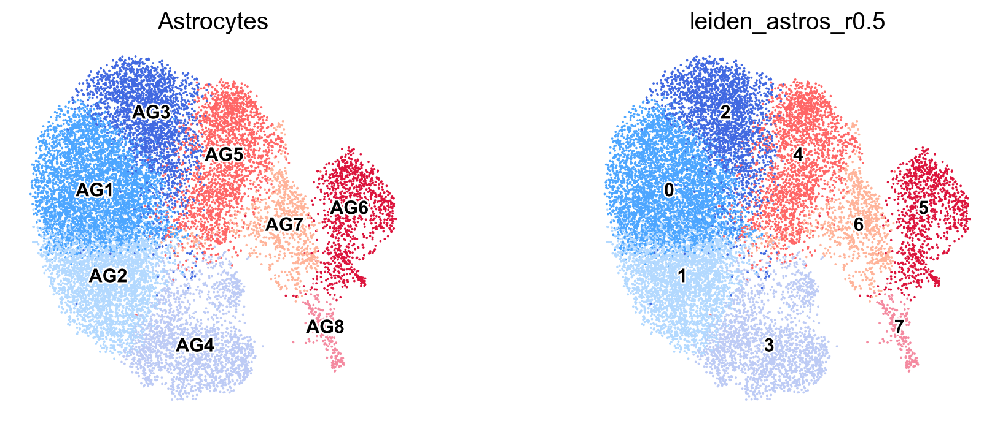

In [29]:
sc.pl.umap(adata_all_astros_proc, color=['clustersastros', 'leiden_astros_r0.5'], legend_fontsize =float(11),title='Astrocytes',legend_loc='on data',legend_fontoutline=2,
           wspace=0.3, legend_fontweight= 'black', frameon= False,palette=clustersA)

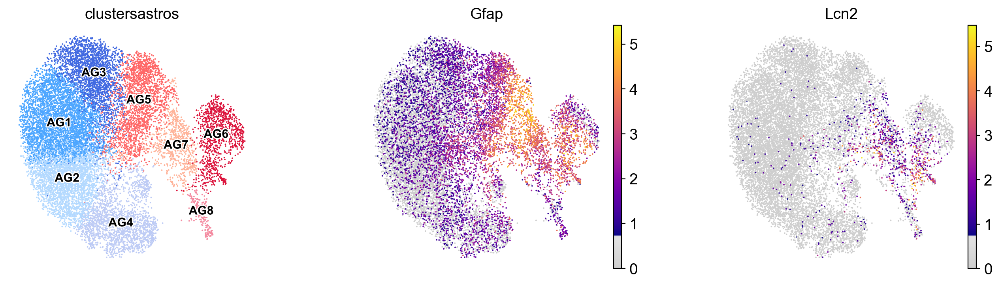

In [30]:
sc.pl.umap(adata_all_astros_proc, color=['clustersastros','Gfap','Lcn2'], legend_fontsize =float(11), legend_loc='on data',legend_fontoutline=2,
           wspace=0.3, legend_fontweight= 'black', frameon= False,palette=clustersA, )#save='_astros_gfap_lcn2.pdf'  )

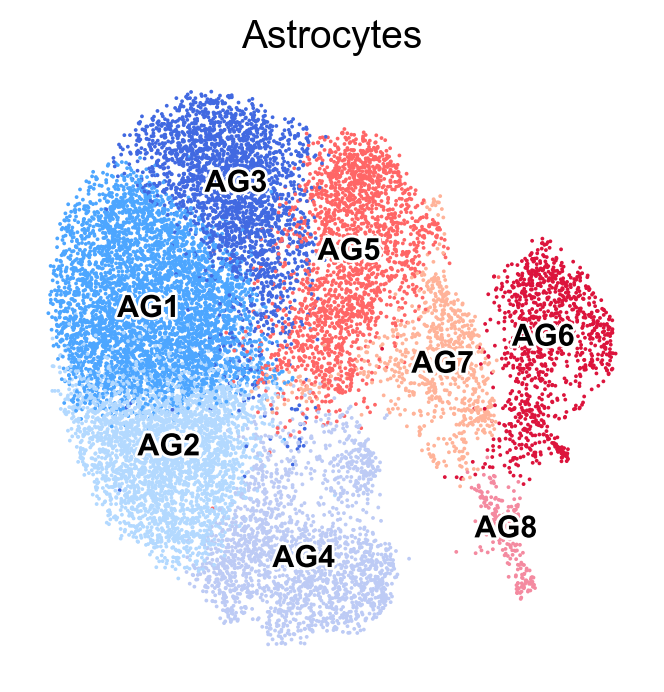

In [31]:
sc.pl.umap(adata_all_astros_proc, color=['clustersastros'], legend_fontsize =float(11),title='Astrocytes',legend_loc='on data',legend_fontoutline=2,
           wspace=0.3, legend_fontweight= 'black', frameon= False,palette=clustersA, save = 'clusters_astros_treated.pdf')

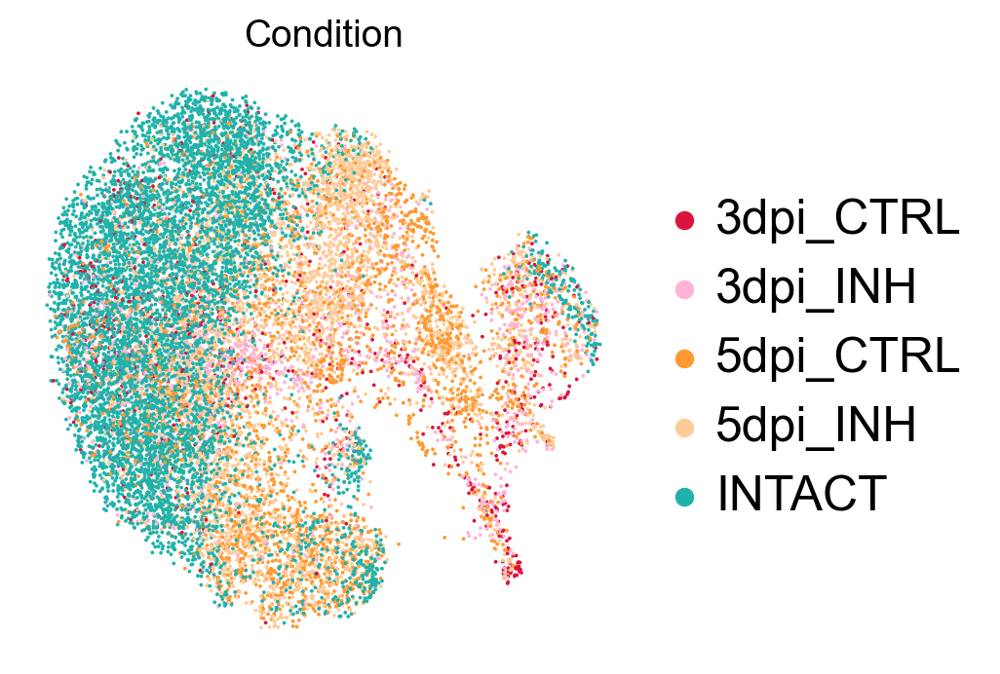

In [32]:
sc.pl.umap(adata_all_astros_proc, color=['condition'], legend_fontsize =float(18),  legend_fontweight= 'normal', title= 'Condition', 
           frameon= False, save = 'conditions_astros_treated.pdf')

In [33]:
adata_all_astros_proc.obs['condition'].value_counts()

INTACT       7134
5dpi_INH     3925
5dpi_CTRL    2771
3dpi_INH     1345
3dpi_CTRL     850
Name: condition, dtype: int64

In [34]:
intact_subsam = sc.pp.subsample(adata_all_astros_proc[adata_all_astros_proc.obs['condition']=='INTACT'],n_obs=850,copy=True).obs_names
five_dpi_I_subsam = sc.pp.subsample(adata_all_astros_proc[adata_all_astros_proc.obs['condition']=='5dpi_INH'],n_obs=850,copy=True).obs_names
five_dpi_V_subsam = sc.pp.subsample(adata_all_astros_proc[adata_all_astros_proc.obs['condition']=='5dpi_CTRL'],n_obs=850,copy=True).obs_names
three_dpi_I_subsam = sc.pp.subsample(adata_all_astros_proc[adata_all_astros_proc.obs['condition']=='3dpi_INH'],n_obs=850,copy=True).obs_names
three_dpi_V_subsam = sc.pp.subsample(adata_all_astros_proc[adata_all_astros_proc.obs['condition']=='3dpi_CTRL'],n_obs=850,copy=True).obs_names
adata_all_astros_proc_subsam = adata_all_astros_proc[list(intact_subsam) + list(five_dpi_I_subsam)+ list(five_dpi_V_subsam)+list(three_dpi_I_subsam)+list(three_dpi_V_subsam)].copy()

In [35]:
sc.tl.embedding_density(adata_all_astros_proc_subsam, basis='umap', groupby='condition')

computing density on 'umap'
--> added
    'umap_density_condition', densities (adata.obs)
    'umap_density_condition_params', parameter (adata.uns)


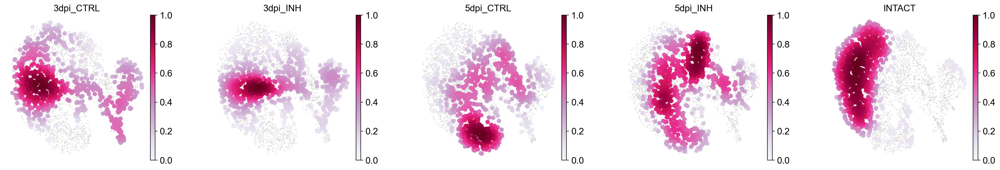

In [36]:
sc.pl.embedding_density(adata_all_astros_proc_subsam, basis='umap',   key='umap_density_condition', color_map='PuRd', wspace=0.3,
                        bg_dotsize = 8, frameon= False, ncols=5, save='_Astros_distribution_downscaling.pdf')

In [37]:
sc.tl.rank_genes_groups(adata_all_astros_proc, groupby='clustersastros', key_added='rank_genes_astros_clustersastros', method='t-test_overestim_var', use_raw=True)

ranking genes
    finished: added to `.uns['rank_genes_astros_clustersastros']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:02)


    using 'X_pca' with n_pcs = 9
Storing dendrogram info using `.uns['dendrogram_clustersastros']`


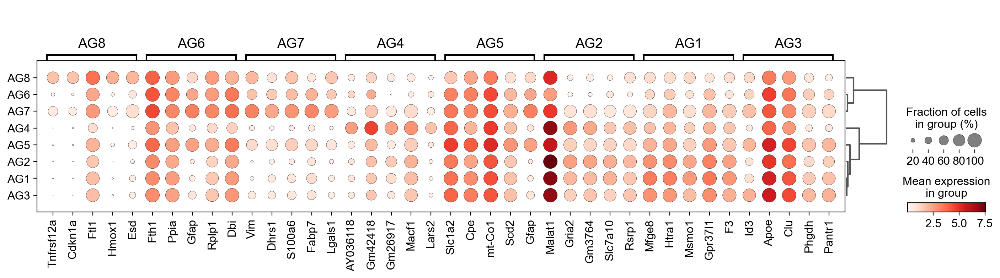

In [38]:
sc.pl.rank_genes_groups_dotplot(adata_all_astros_proc, n_genes=5, key='rank_genes_astros_clustersastros', cmap='Reds', save='rank_astros.pdf')

In [39]:
result = adata_all_astros_proc.uns['rank_genes_astros_clustersastros']
groups = result['names'].dtype.names
adata_clastros_genes = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names','scores', 'pvals','logfoldchanges']})

In [40]:
adata_clastros_genes

,AG1_n,AG1_s,AG1_p,AG1_l,AG2_n,AG2_s,AG2_p,AG2_l,AG3_n,AG3_s,...,AG6_p,AG6_l,AG7_n,AG7_s,AG7_p,AG7_l,AG8_n,AG8_s,AG8_p,AG8_l
0,Mfge8,59.941338,0.000000e+00,1.706140,Malat1,44.450562,0.000000e+00,1.830603,Id3,35.690014,...,7.563103e-154,1.518860,Vim,63.519516,0.000000e+00,5.110455,Tnfrsf12a,22.578648,5.692492e-63,5.967064
1,Htra1,57.919025,0.000000e+00,1.347117,Gria2,40.857113,0.000000e+00,1.465444,Apoe,34.896862,...,2.322399e-116,1.146431,Dhrs1,52.141594,0.000000e+00,3.541964,Cdkn1a,22.308952,1.942774e-61,6.064290
2,Msmo1,56.794930,0.000000e+00,1.651628,Gm3764,40.819042,0.000000e+00,1.441872,Clu,31.635359,...,9.512860e-111,2.616652,S100a6,50.819218,0.000000e+00,3.736197,Ftl1,22.137877,1.279312e-73,2.887968
3,Gpr37l1,54.210476,0.000000e+00,1.321069,Slc7a10,33.217918,7.796446e-222,1.176337,Phgdh,29.654711,...,7.083271e-111,1.590506,Fabp7,48.996677,0.000000e+00,3.724173,Hmox1,20.691727,1.283218e-55,6.226635
4,F3,52.772633,0.000000e+00,1.408903,Rsrp1,27.364864,1.187039e-155,0.978058,Pantr1,29.326532,...,2.043314e-104,1.328457,Lgals1,48.114143,3.675041e-314,4.238169,Esd,19.691990,3.479379e-58,3.746886
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19285,C4b,-21.867197,1.487706e-102,-1.789772,S100a6,-24.949017,3.955003e-130,-1.627002,Gria2,-19.093760,...,0.000000e+00,-4.261532,Pnisr,-30.511524,9.173258e-152,-2.248981,Acsl3,-26.403467,6.271978e-89,-4.179335
19286,Lars2,-22.812649,6.566220e-111,-1.728214,Ntrk2,-25.098660,2.344338e-132,-0.903996,Olig1,-19.136499,...,0.000000e+00,-3.441688,Acsl3,-30.889959,1.158036e-163,-1.969636,Plpp3,-27.864355,2.946956e-99,-3.738267
19287,Serpina3n,-23.418060,6.721717e-116,-2.558432,Gfap,-29.858593,1.143241e-179,-2.395520,Gm26917,-20.341196,...,0.000000e+00,-4.589383,Mfge8,-31.262426,3.285598e-165,-2.332484,Bcan,-28.027132,1.263826e-99,-4.040641
19288,Vim,-33.009838,1.618001e-218,-2.493941,Vim,-30.114674,1.882547e-179,-2.988635,Sparc,-27.458214,...,0.000000e+00,-3.454684,Ntsr2,-35.504288,4.665667e-207,-2.379508,Atp1a2,-28.280342,2.239487e-92,-3.632477


In [41]:
adata_clastros_genes.to_csv(table_dir+'adata_clastros_genes.csv')

In [42]:
adata_all_astros_proc.obs['condition'].value_counts()

INTACT       7134
5dpi_INH     3925
5dpi_CTRL    2771
3dpi_INH     1345
3dpi_CTRL     850
Name: condition, dtype: int64

In [43]:
astros_inj=adata_all_astros_proc[np.in1d(adata_all_astros_proc.obs['condition'], 
                           ['3dpi_CTRL','3dpi_INH','5dpi_CTRL','5dpi_INH'])].copy()

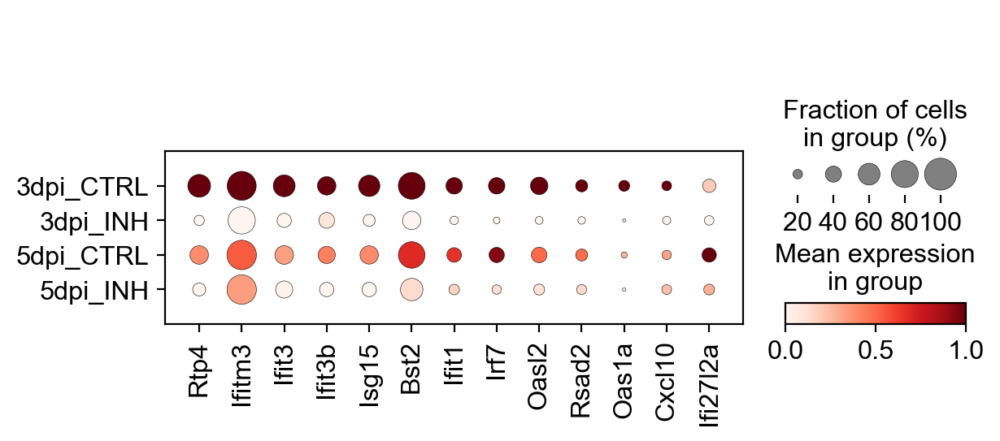

In [44]:
sc.pl.dotplot(astros_inj[astros_inj.obs['clustersastros']=='AG7'],
              var_names=['Rtp4','Ifitm3','Ifit3','Ifit3b','Isg15','Bst2','Ifit1','Irf7','Oasl2',#downregulated shared inflammatory genes
                         'Rsad2','Oas1a','Cxcl10','Ifi27l2a'],standard_scale='var',
              groupby='condition', save='_inf_genes_AG7_inj.pdf')

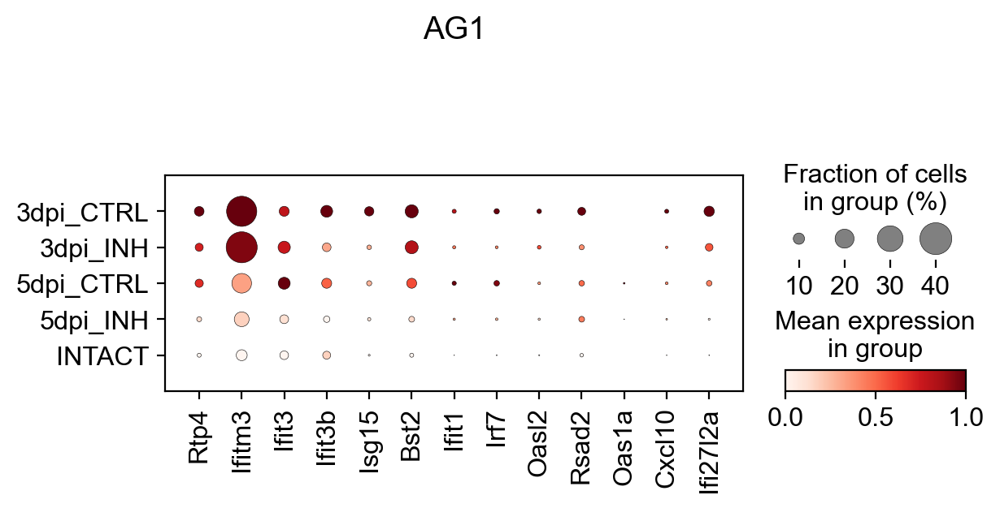

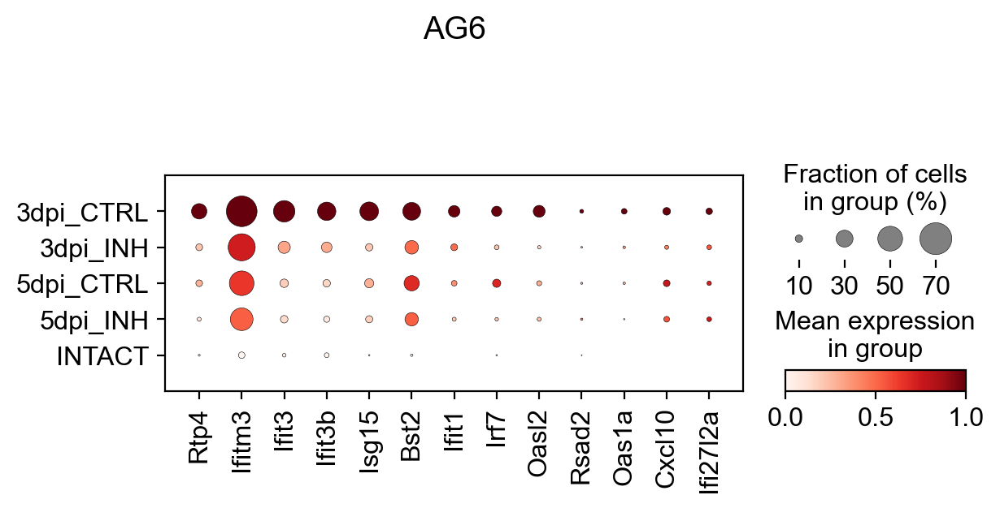

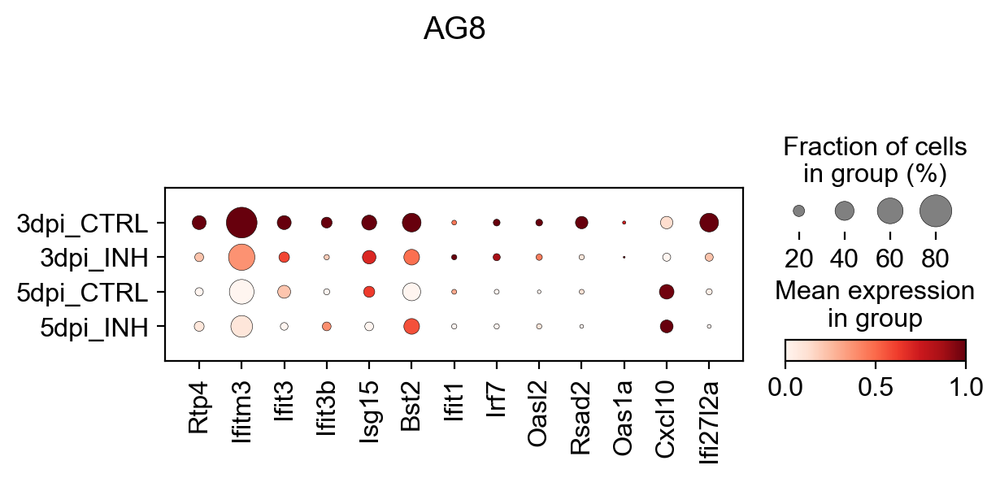

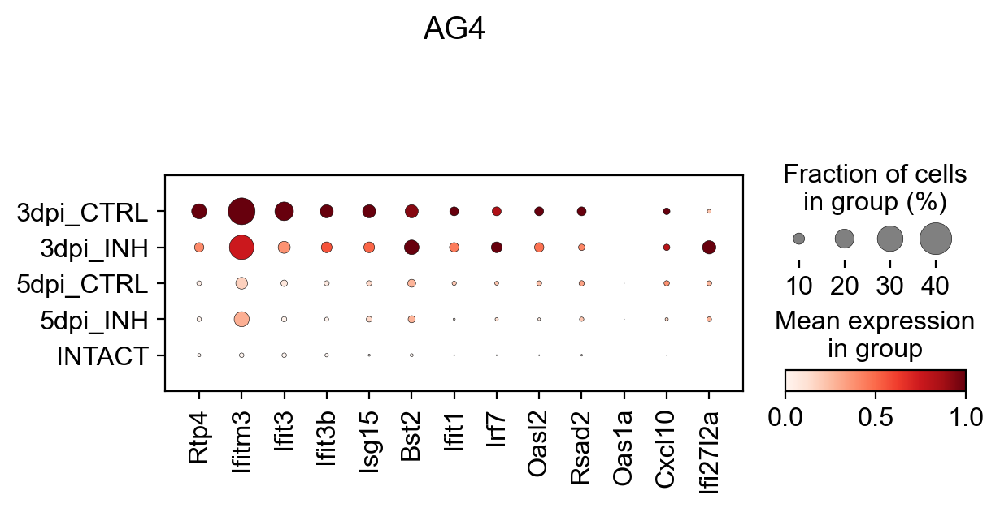

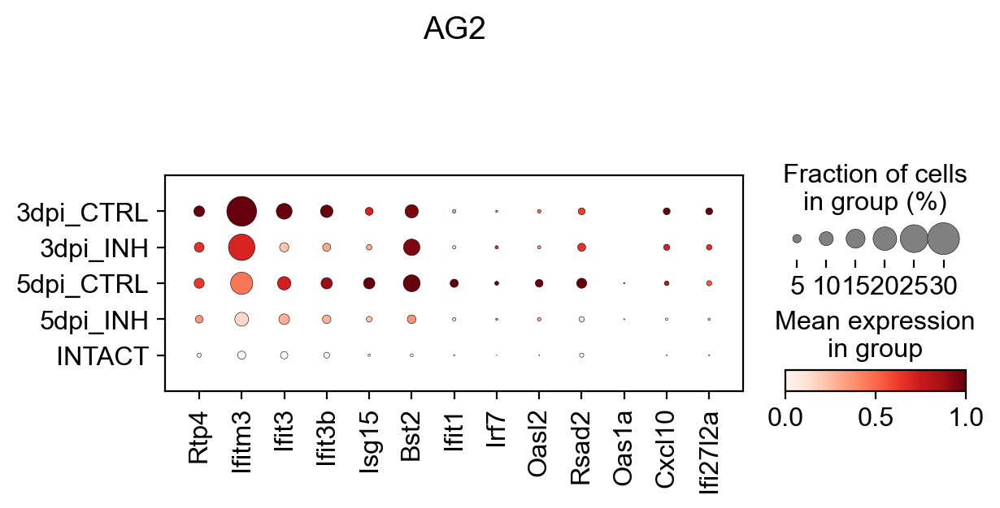

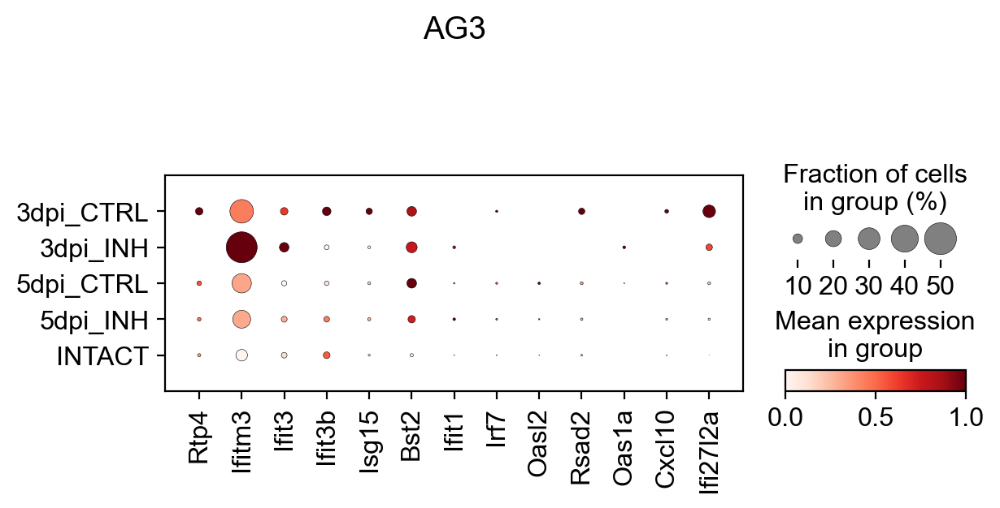

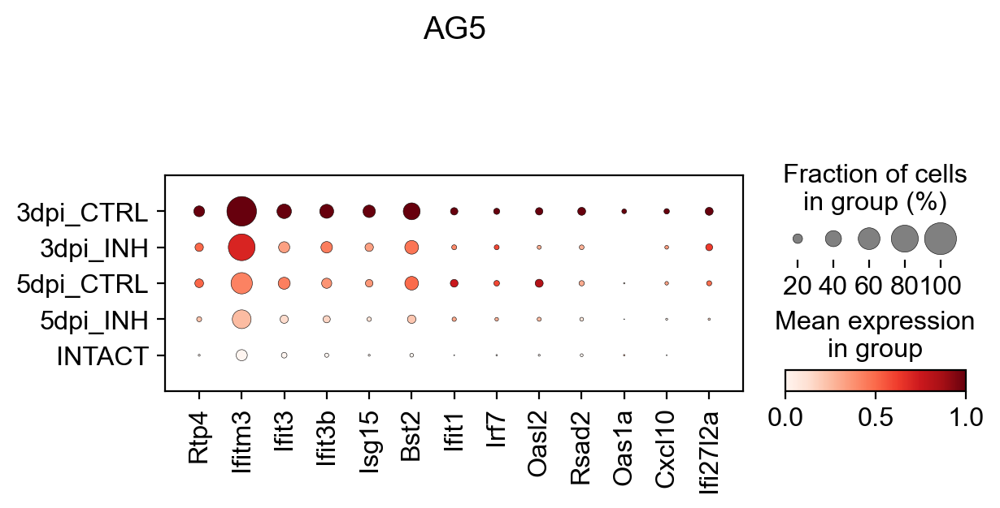

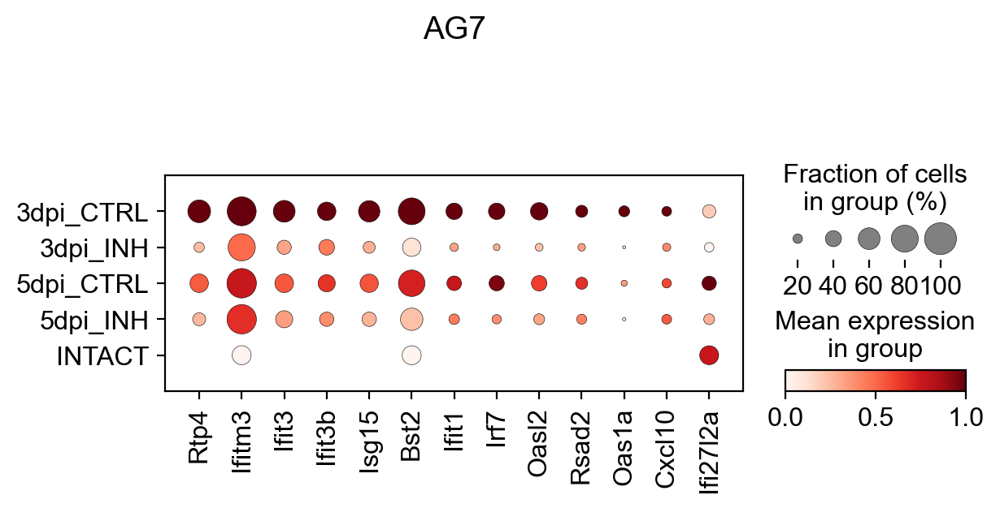

In [45]:
for ex in set(adata_all_astros_proc.obs['clustersastros']):
    sc.pl.dotplot(adata_all_astros_proc[adata_all_astros_proc.obs['clustersastros']==ex],
              var_names=['Rtp4','Ifitm3','Ifit3','Ifit3b','Isg15','Bst2','Ifit1','Irf7','Oasl2',#downregulated shared inflammatory genes
                         'Rsad2','Oas1a','Cxcl10','Ifi27l2a'],standard_scale='var',title=ex,
              groupby='condition', save='_inf_genes_'+ex+'.pdf')

In [46]:
astros_3dpi=adata_all_astros_proc[np.in1d(adata_all_astros_proc.obs['condition'], 
                           ['3dpi_CTRL','3dpi_INH'])].copy()

In [47]:
astros_5dpi=adata_all_astros_proc[np.in1d(adata_all_astros_proc.obs['condition'], 
                           ['5dpi_CTRL','5dpi_INH'])].copy()

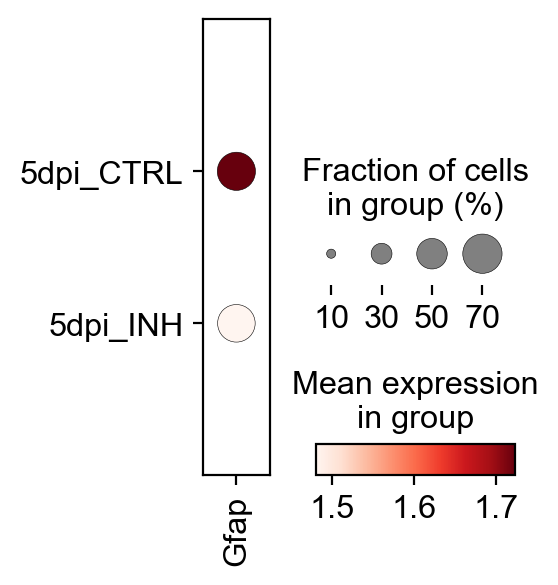

In [48]:
sc.pl.dotplot(astros_5dpi,
              var_names=['Gfap'],title='',figsize=(2,3),
              groupby='condition', save='_5dpi_gfap.pdf')

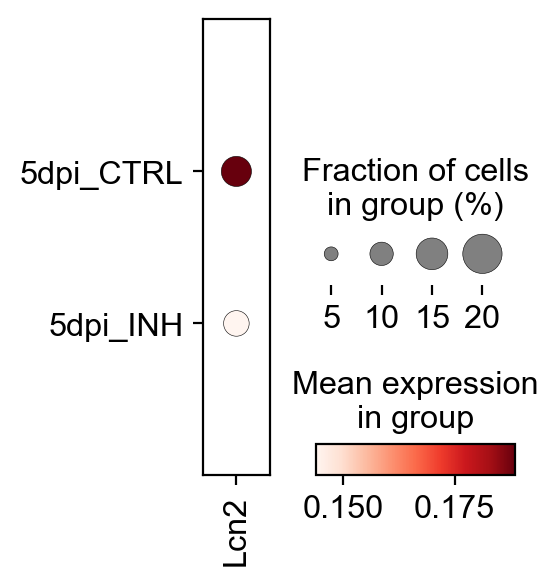

In [49]:
sc.pl.dotplot(astros_5dpi,
              var_names=['Lcn2'],title='',figsize=(2,3),
              groupby='condition', save='_5dpi_lcn222.pdf')

In [50]:
reactive_astrocytes = {'Cl4': ['Lcn2','Ifitm3','H2-D1','Timp1','B2m','Vim','Gfap','Psmb8','Bst2','H2-T23','Cd63','Serping1','Tspo','Rps4x',
                               'S100a6','Tuba1a','H2-K1','Mt1','Gpx1','S100a11'],
                      'Cl8': ['Igtp','Gm4951','Iigp1','Irgm1','Tap1','Ifit3','Gbp2','F830016B08Rik','Gbp7','Tap2','Ifi47','B2m','Ifit1','Psmb8',
                              'Stat1','H2-T23','Usp18','Ifit3b','Rtp4','Psmb9']}#Hasel et.al2021

In [51]:
pd.DataFrame(reactive_astrocytes)

,Cl4,Cl8
0,Lcn2,Igtp
1,Ifitm3,Gm4951
2,H2-D1,Iigp1
3,Timp1,Irgm1
4,B2m,Tap1
5,Vim,Ifit3
6,Gfap,Gbp2
7,Psmb8,F830016B08Rik
8,Bst2,Gbp7
9,H2-T23,Tap2


In [52]:
sc.tl.score_genes(adata_all_astros_proc, reactive_astrocytes['Cl4'], score_name='reactive_cl4' )
sc.tl.score_genes(adata_all_astros_proc, reactive_astrocytes['Cl8'], score_name='reactive_cl8' )

computing score 'reactive_cl4'
    finished: added
    'reactive_cl4', score of gene set (adata.obs).
    499 total control genes are used. (0:00:00)
computing score 'reactive_cl8'
    finished: added
    'reactive_cl8', score of gene set (adata.obs).
    548 total control genes are used. (0:00:00)


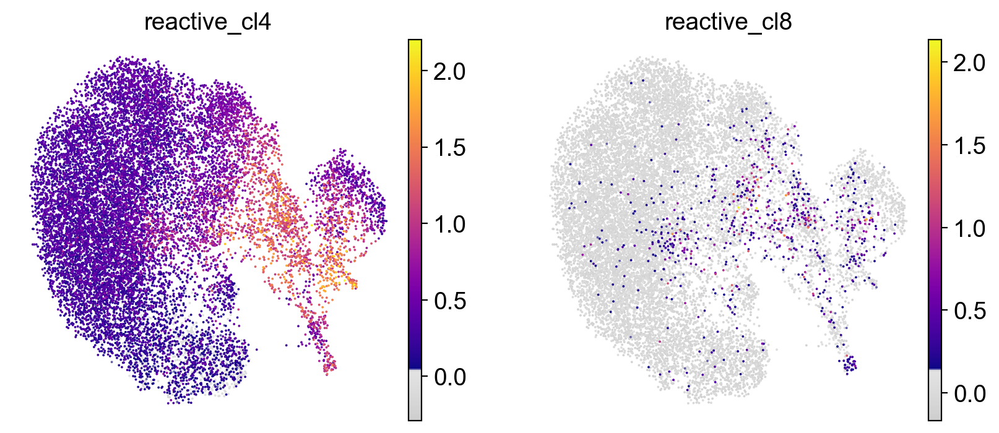

In [53]:
sc.pl.umap(adata_all_astros_proc, color=['reactive_cl4','reactive_cl8'], legend_fontsize =float(18),legend_fontoutline=2,
            legend_fontweight= 'black', frameon= False, ) #Hasel et.al2021


In [54]:
astros_reactive=adata_all_astros_proc[np.in1d(adata_all_astros_proc.obs['clustersastros'], 
                           ['AG5','AG6','AG7','AG8'])].copy()

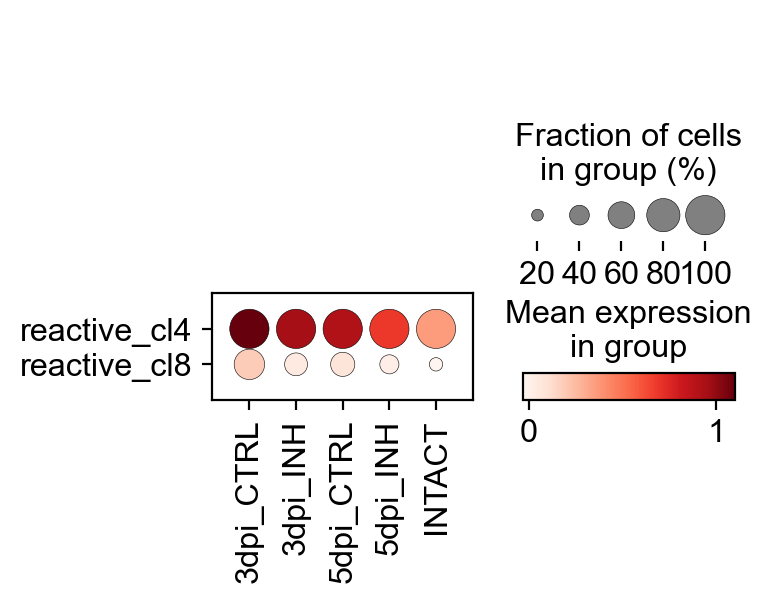

In [55]:
sc.pl.dotplot(astros_reactive,
              var_names=['reactive_cl4','reactive_cl8'],swap_axes=True,
              groupby='condition', save='_reactivity_astros_ag5678.pdf')

In [56]:
adata_all_astros_proc

AnnData object with n_obs × n_vars = 16025 × 15747
    obs: 'sample_id', 'condition', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'n_counts', 'n_genes', 'doublet_score', 'doublet', 'size_factors', 'leiden', '_scvi_batch', '_scvi_labels', 'leiden_scVI', 'leiden13', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'leiden_all', 'S_score', 'G2M_score', 'phase', 'Cycling cells', 'cell_cycle', 'Microglia', 'DAM', 'Macrophages', 'BAM', 'Monocytes', 'DCs', 'NKT cells', 'T cells', 'B cells', 'Neutrophils', 'Neurons', 'OPCs', 'COPs', 'MOL', 'Astrocytes', 'Pericytes', 'VSMCs', 'VLMCs', 'VEC', 'annotated', 'annotated_group', 'leiden_astros_r1', 'leiden_astros_r0.5', 'leiden_astros_r0.4', 'leiden_astros_r0.6', 'clustersastros', 'reactive_

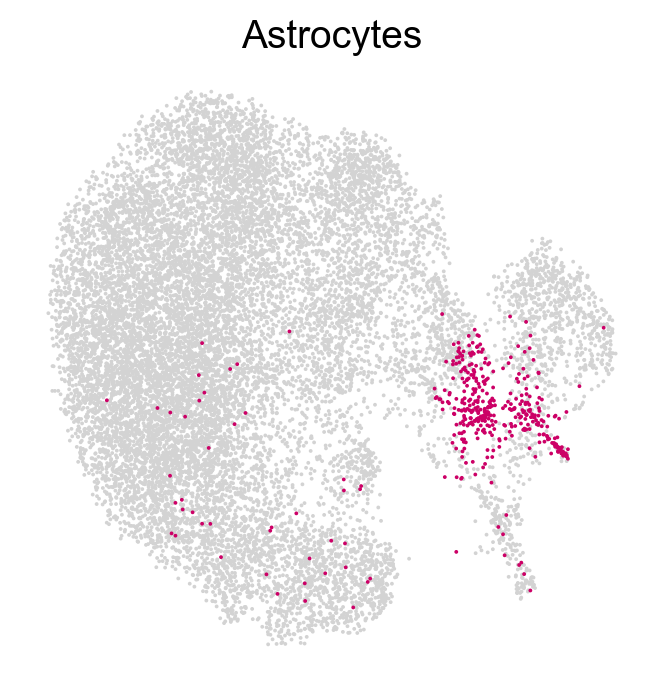

In [57]:
sc.pl.umap(adata_all_astros_proc, color=['cell_cycle'], groups='cycling', na_in_legend=False,legend_fontsize =float(18), 
           frameon= False, title= 'Astrocytes', legend_loc='none', save='_2A_phase.pdf')

In [58]:
cyclingcell_astros=pd.crosstab(adata_all_astros_proc_subsam.obs['cell_cycle'], adata_all_astros_proc_subsam.obs['condition'], normalize='columns')

In [59]:
cyclingcell_astros_sub=pd.crosstab(adata_all_astros_proc_subsam.obs['cell_cycle'], adata_all_astros_proc_subsam.obs['condition'])

In [60]:
cyclingcell_astros_all=pd.crosstab(adata_all_astros_proc.obs['cell_cycle'], adata_all_astros_proc.obs['condition'])

In [61]:
cyclingcell_astros_all

condition,3dpi_CTRL,3dpi_INH,5dpi_CTRL,5dpi_INH,INTACT
cell_cycle,,,,,
resting,824,1321,2603,3738,7116
cycling,26,24,168,187,18


In [62]:
cyclingcell_astros_all

condition,3dpi_CTRL,3dpi_INH,5dpi_CTRL,5dpi_INH,INTACT
cell_cycle,,,,,
resting,824,1321,2603,3738,7116
cycling,26,24,168,187,18


In [63]:
cyclingcell_astros_sub

condition,3dpi_CTRL,3dpi_INH,5dpi_CTRL,5dpi_INH,INTACT
cell_cycle,,,,,
resting,824,834,802,797,849
cycling,26,16,48,53,1


In [64]:
cyclingcell_astros_sub

condition,3dpi_CTRL,3dpi_INH,5dpi_CTRL,5dpi_INH,INTACT
cell_cycle,,,,,
resting,824,834,802,797,849
cycling,26,16,48,53,1


In [65]:
cyclingcell_astros=cyclingcell_astros.T*100

In [66]:
cyclingcell_astros

cell_cycle,resting,cycling
condition,,
3dpi_CTRL,96.941176,3.058824
3dpi_INH,98.117647,1.882353
5dpi_CTRL,94.352941,5.647059
5dpi_INH,93.764706,6.235294
INTACT,99.882353,0.117647


In [67]:
cyclingcell_astros=cyclingcell_astros.reindex(['INTACT','3dpi_CTRL', '3dpi_INH', '5dpi_CTRL', '5dpi_INH'])

In [68]:
fields = ['resting','cycling']
colors = ['#c2c2d6', '#cc0066']
labels = ['resting', 'cycling']

In [69]:
list(cyclingcell_astros['cycling'])

[0.1176470588235294,
 3.058823529411765,
 1.8823529411764703,
 5.647058823529412,
 6.235294117647059]

In [70]:
cyclingcell_astros=pd.DataFrame({'Sample': [ 'INTACT','3dpi_CTRL', '3dpi_INH', '5dpi_CTRL', '5dpi_INH',], 
'resting': cyclingcell_astros['resting'] ,
'cycling': cyclingcell_astros['cycling']})


In [71]:
cyclingcell_astros

,Sample,resting,cycling
condition,,,
INTACT,INTACT,99.882353,0.117647
3dpi_CTRL,3dpi_CTRL,96.941176,3.058824
3dpi_INH,3dpi_INH,98.117647,1.882353
5dpi_CTRL,5dpi_CTRL,94.352941,5.647059
5dpi_INH,5dpi_INH,93.764706,6.235294


Text(0, 0.5, 'Cycling cells (%)')

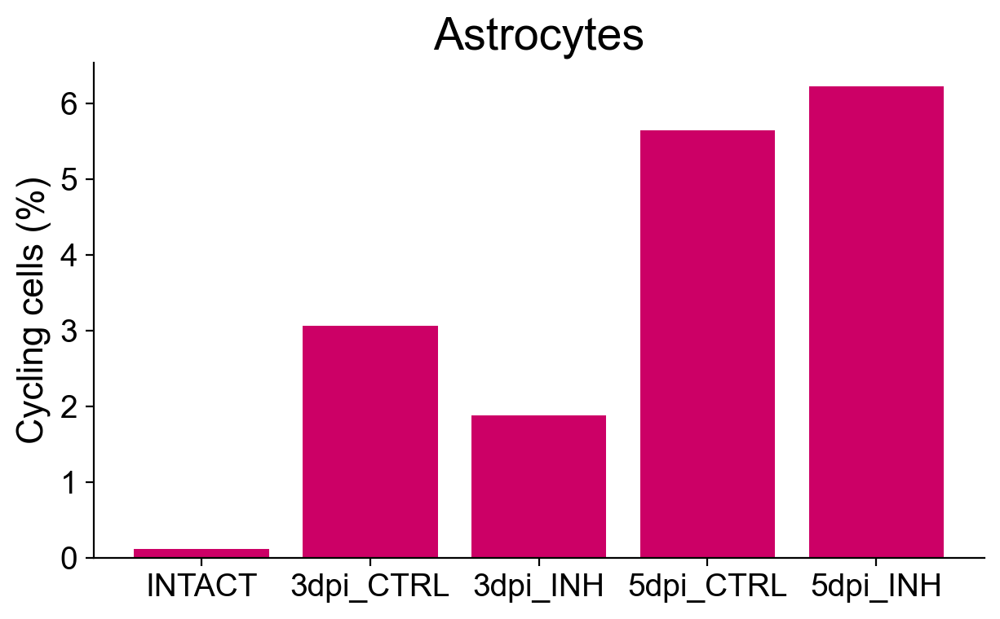

In [72]:
# figure and axis
fig, ax = plt.subplots(1, figsize=(7, 4))
ax.bar(cyclingcell_astros['Sample'],cyclingcell_astros['cycling'],color='#cc0066',)
plt.title('Astrocytes', loc='center', fontsize="20")
ax.set_axisbelow(True)
plt.grid(b=None)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(True)
ax.spines['top'].set_visible(False)
ax.spines['bottom'].set_visible(True)
plt.ylabel('Cycling cells (%)', fontsize=16)
#plt.savefig('/Volumes/Seagate_Exp/Paper_sc_analysis/notebooks/analysis_early_time_points/040522_corrected_notebooks/Paper_figures/220713/cyclngcells_astros.pdf', dpi=300)

In [73]:
adata_all_astros_proc.write(data_dir+today + "adata_treated_astros_proc_scVI.h5ad")

# Microglia

## Read Data & downstream analysis

In [74]:
adata_all_micro_proc = sc.read(data_dir + '230807adata_all_micro_treated_scVI.h5ad')

In [75]:
#Filter genes:
print('Total number of genes: {:d}'.format(adata_all_micro_proc.n_vars))

# Min 20 cells - filters out 0 count genes
sc.pp.filter_genes(adata_all_micro_proc, min_cells=20)
print('Number of genes after cell filter: {:d}'.format(adata_all_micro_proc.n_vars))

Total number of genes: 19290
filtered out 4657 genes that are detected in less than 20 cells
Number of genes after cell filter: 14633


In [76]:
# use scVI latent space for UMAP generation
sc.pp.neighbors(adata_all_micro_proc, use_rep="X_scVI") 


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


In [77]:
sc.tl.umap(adata_all_micro_proc,)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:04)


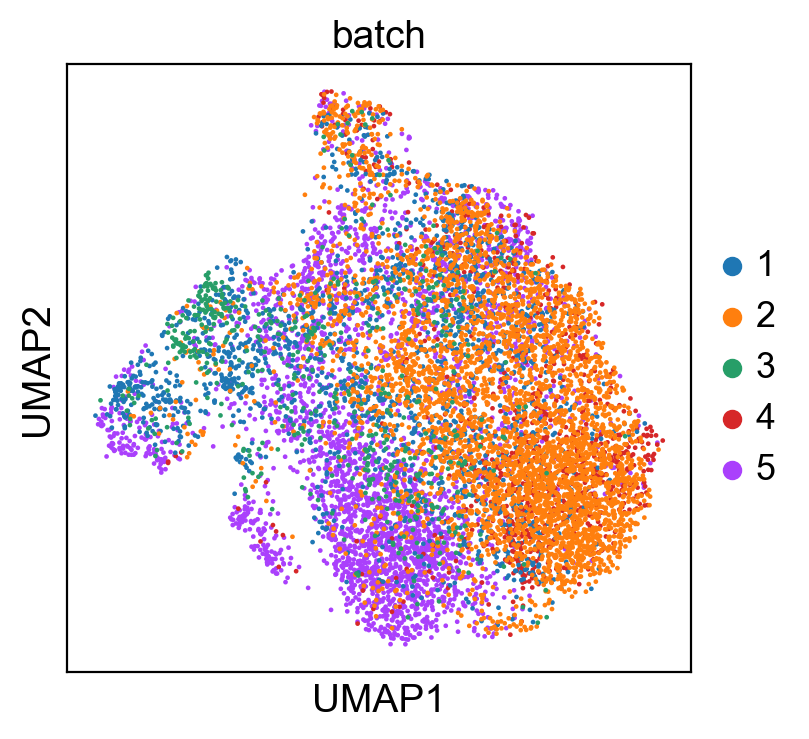

In [78]:
sc.pl.umap(adata_all_micro_proc, color=['batch'])

In [79]:
sc.tl.leiden(adata_all_micro_proc, key_added='leiden_micro_r1')
sc.tl.leiden(adata_all_micro_proc, resolution=0.5, key_added='leiden_micro_r0.5')
sc.tl.leiden(adata_all_micro_proc, resolution=0.4, key_added='leiden_micro_r0.4')
sc.tl.leiden(adata_all_micro_proc, resolution=0.3, key_added='leiden_micro_r0.3')

running Leiden clustering
    finished: found 13 clusters and added
    'leiden_micro_r1', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 8 clusters and added
    'leiden_micro_r0.5', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 8 clusters and added
    'leiden_micro_r0.4', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 7 clusters and added
    'leiden_micro_r0.3', the cluster labels (adata.obs, categorical) (0:00:00)


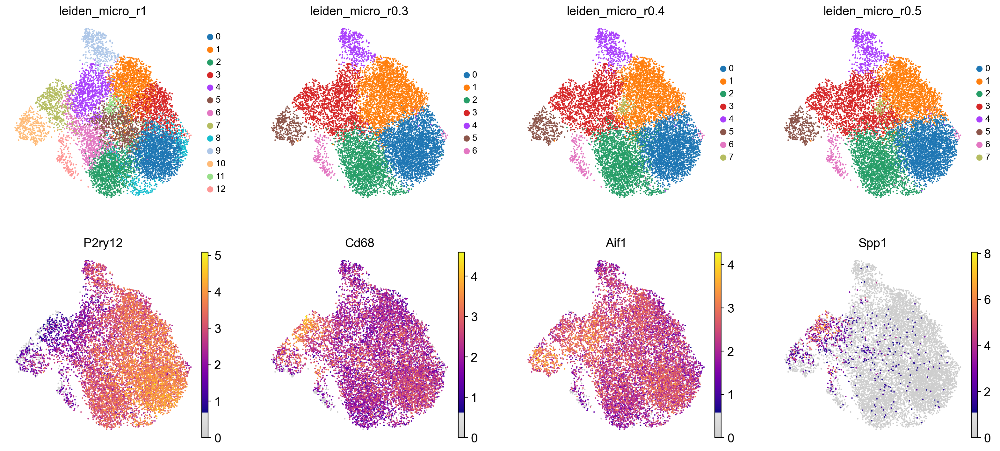

In [80]:
sc.pl.umap(adata_all_micro_proc, color=['leiden_micro_r1','leiden_micro_r0.3','leiden_micro_r0.4','leiden_micro_r0.5' ,'P2ry12', 'Cd68','Aif1','Spp1'], legend_fontsize =float(10),
           legend_fontweight= 'normal', frameon= False,cmap=mymap2  )

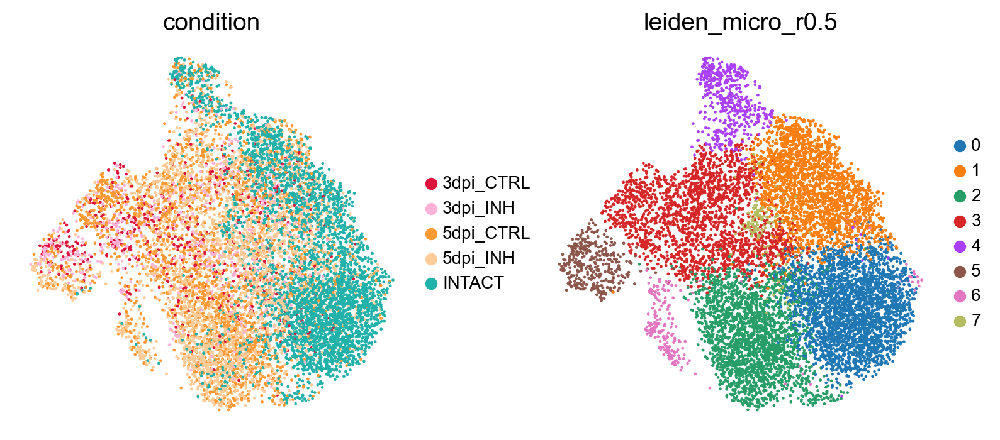

In [81]:
sc.pl.umap(adata_all_micro_proc, color=['condition','leiden_micro_r0.5'], legend_fontsize =float(10), legend_fontweight= 'normal',  frameon= False, )

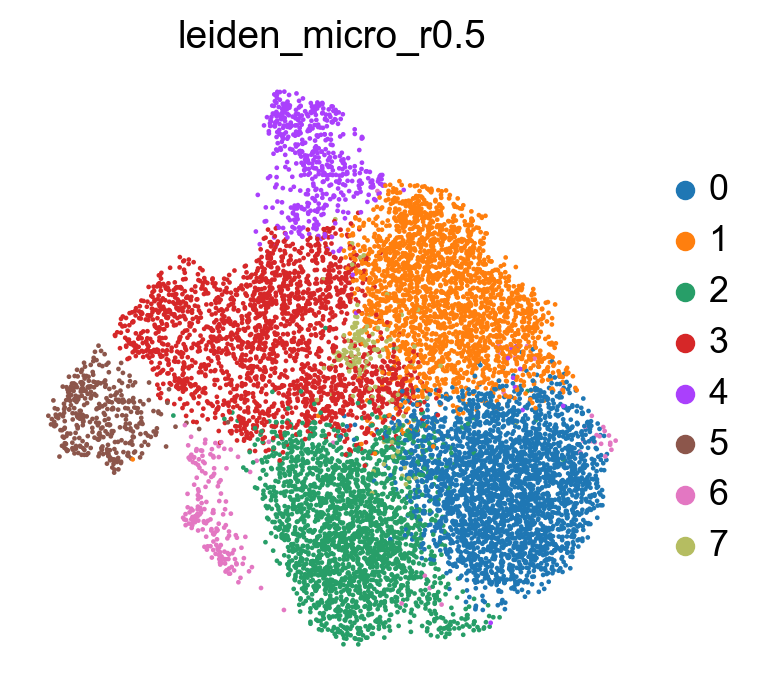

In [82]:
sc.pl.umap(adata_all_micro_proc, color=['leiden_micro_r0.5'], frameon=False, wspace=0.5)

In [83]:
sc.tl.rank_genes_groups(adata_all_micro_proc, groupby='leiden_micro_r0.5', key_added='rank_genes_micro_r0.5', method='t-test_overestim_var', use_raw=True)

ranking genes
    finished: added to `.uns['rank_genes_micro_r0.5']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


    using 'X_pca' with n_pcs = 9
Storing dendrogram info using `.uns['dendrogram_leiden_micro_r0.5']`


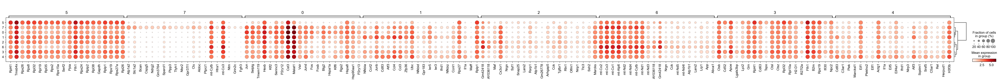

In [84]:
sc.pl.rank_genes_groups_dotplot(adata_all_micro_proc, n_genes=20, key='rank_genes_micro_r0.5')

## Plots for figures

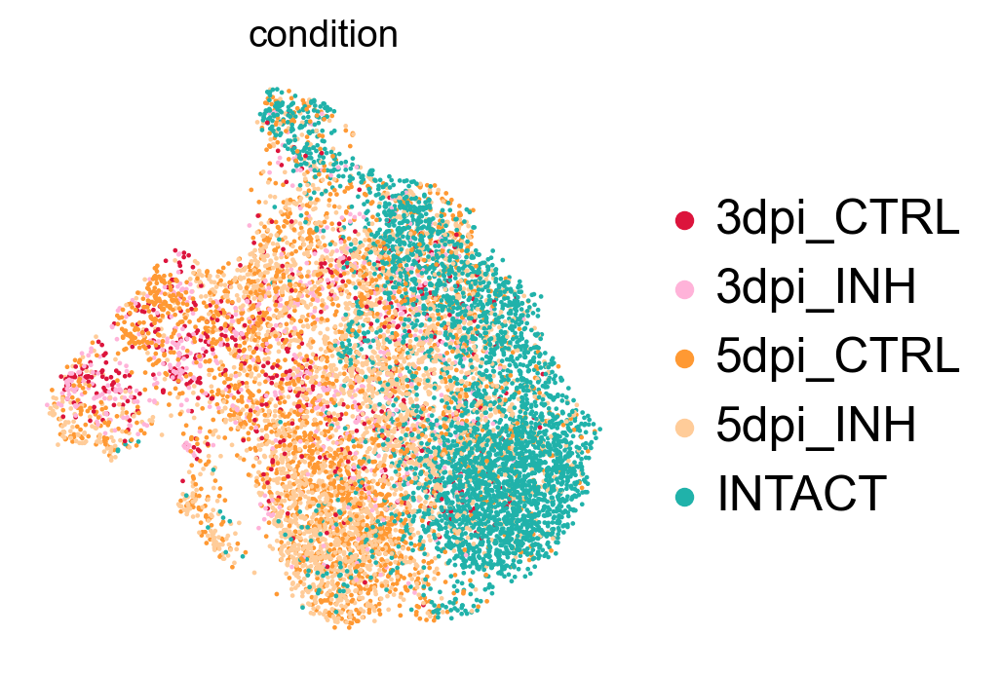

In [85]:
sc.pl.umap(adata_all_micro_proc, color=['condition'], legend_fontsize =float(18),  legend_fontweight= 'normal', frameon= False, )#save='_3M_conditions.pdf' )

In [86]:
clustersM= ['#4da6ff',# 0
            '#b3d9ff',# 1
            '#4169E1',# 2
            '#ff6666',# 3
            '#bdcbf5',# 4          
            '#ffb399',# 5
            '#92a8d1',# 6
            '#66ccff', # 7
            '#66ccff'
      ]

In [87]:
cluster2annotation = {
    '0': 'MG1',
    '1': 'MG2',
    '2': 'MG3',
    '3': 'MG4',
    '4': 'MG5',
    '5': 'MG6',
    '6': 'MG7',
    '7': 'MG8',
    '8': 'MG9'
    }

In [88]:
adata_all_micro_proc.obs['clustersmicro'] = adata_all_micro_proc.obs['leiden_micro_r0.5'].map(cluster2annotation).astype('category')

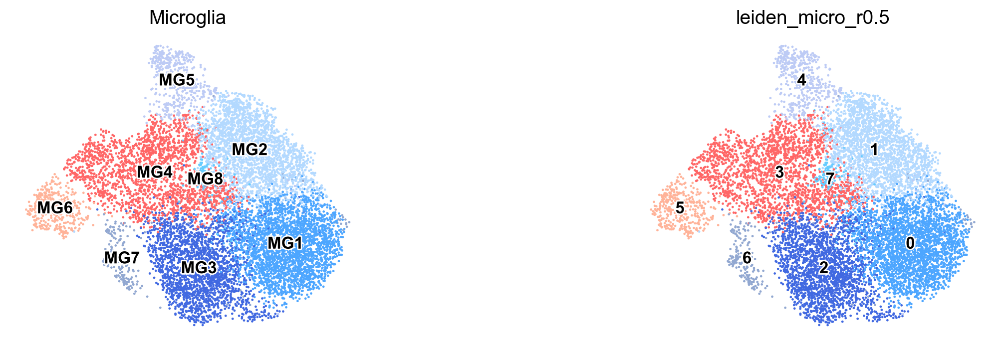

In [89]:
sc.pl.umap(adata_all_micro_proc, color=['clustersmicro','leiden_micro_r0.5'],title='Microglia', legend_fontsize =float(12),legend_fontoutline=2,palette=clustersM,legend_loc='on data',
           wspace=0.6, legend_fontweight= 'black', frameon= False, )#save='_1M_clusters.pdf'  )

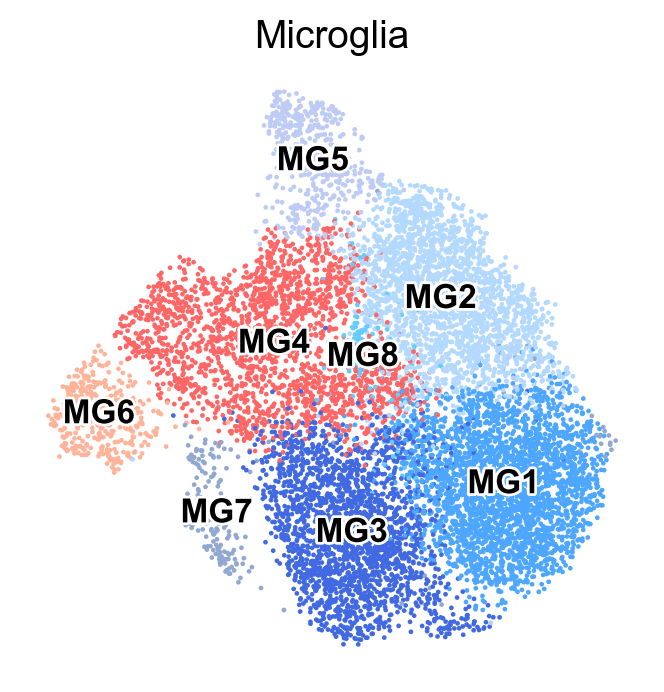

In [90]:
sc.pl.umap(adata_all_micro_proc, color=['clustersmicro'],title='Microglia', legend_fontsize =float(12),legend_fontoutline=2,palette=clustersM,legend_loc='on data',
           wspace=0.6, legend_fontweight= 'black', frameon= False, save='_1M_clusters.pdf'  )

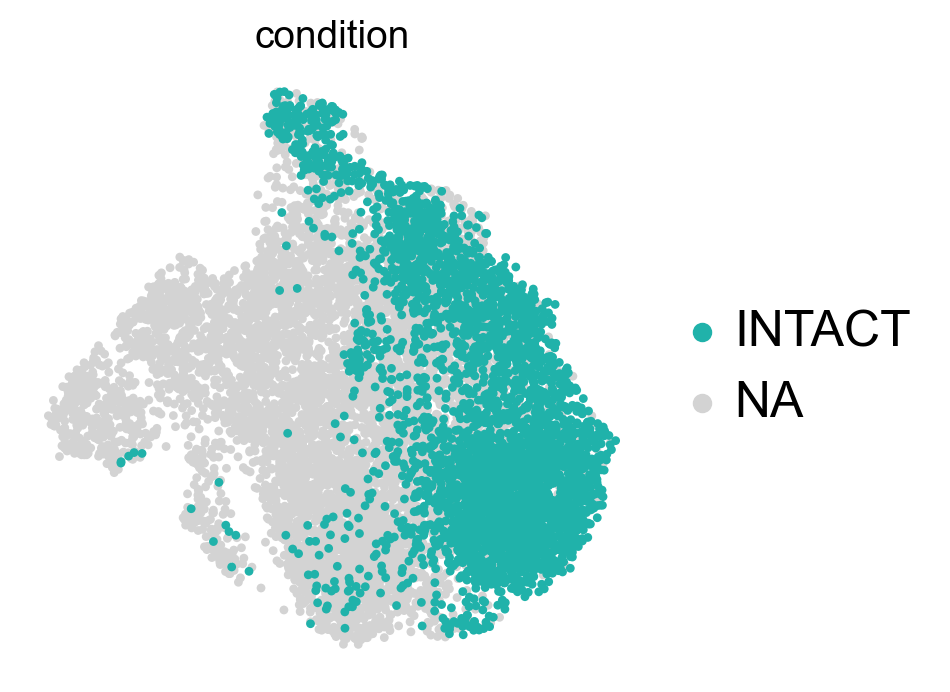

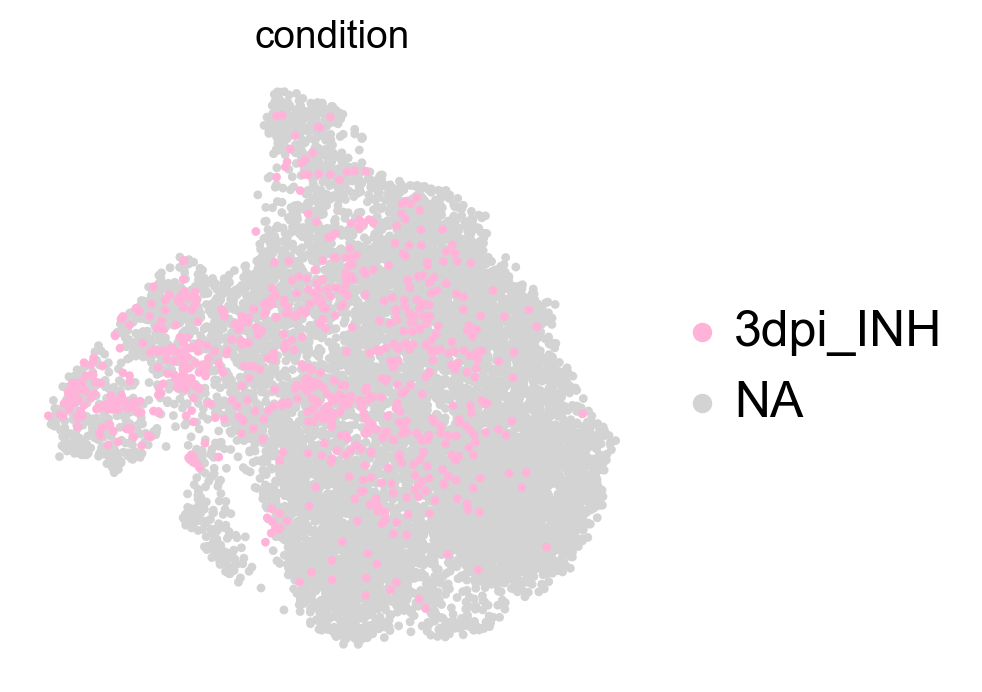

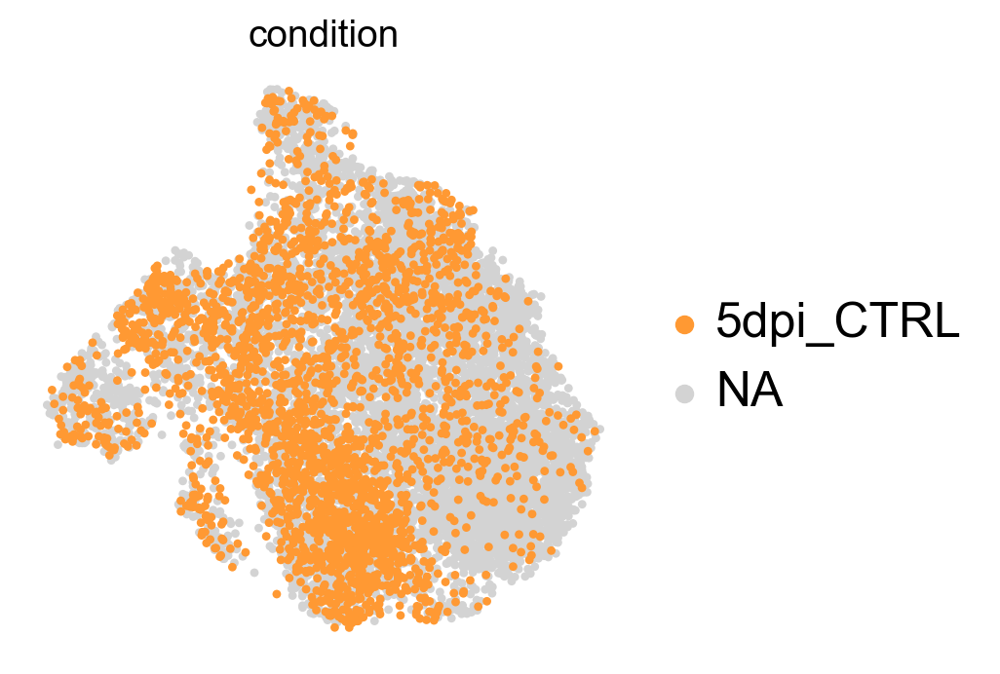

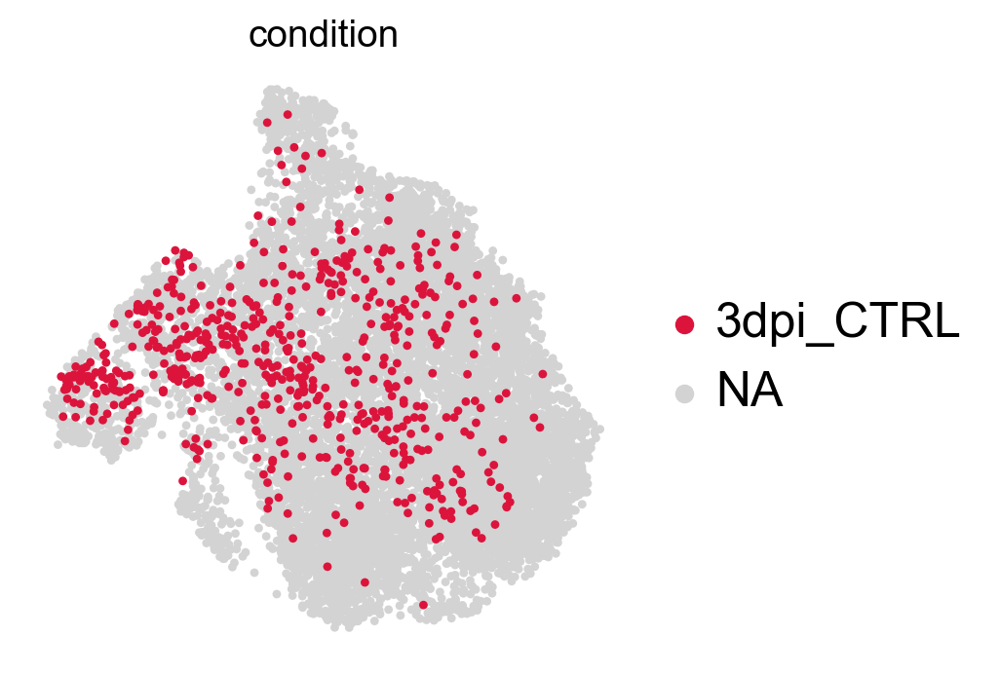

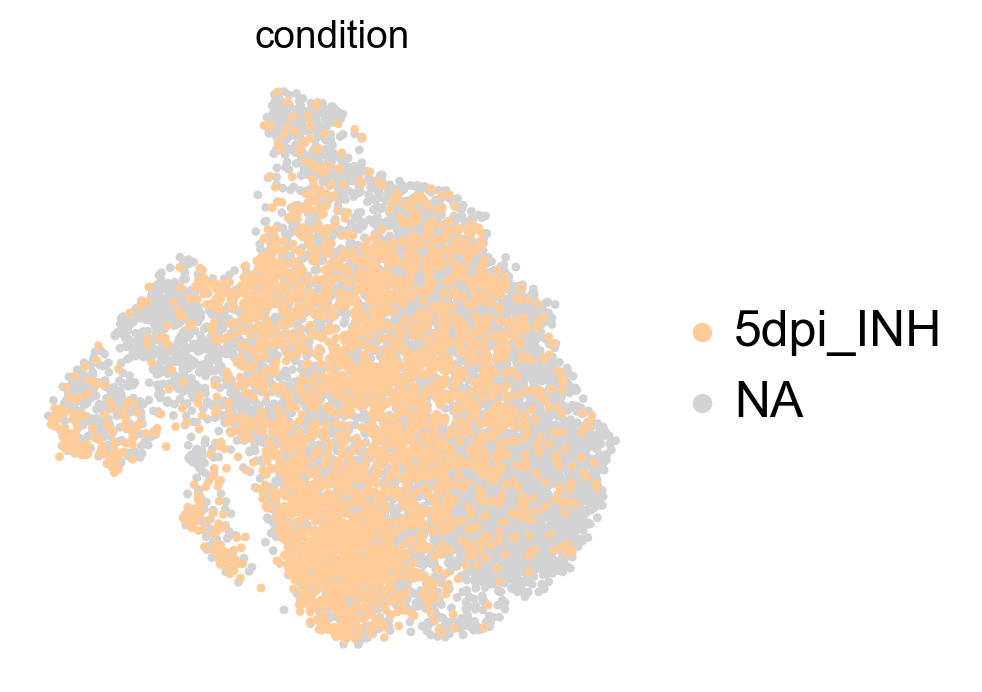

In [145]:
for i in set(adata_all_micro_proc.obs['condition']):
             sc.pl.umap(adata_all_micro_proc, color=['condition'], legend_fontsize =float(18), groups=i, legend_fontweight= 'normal', size=40,frameon= False )

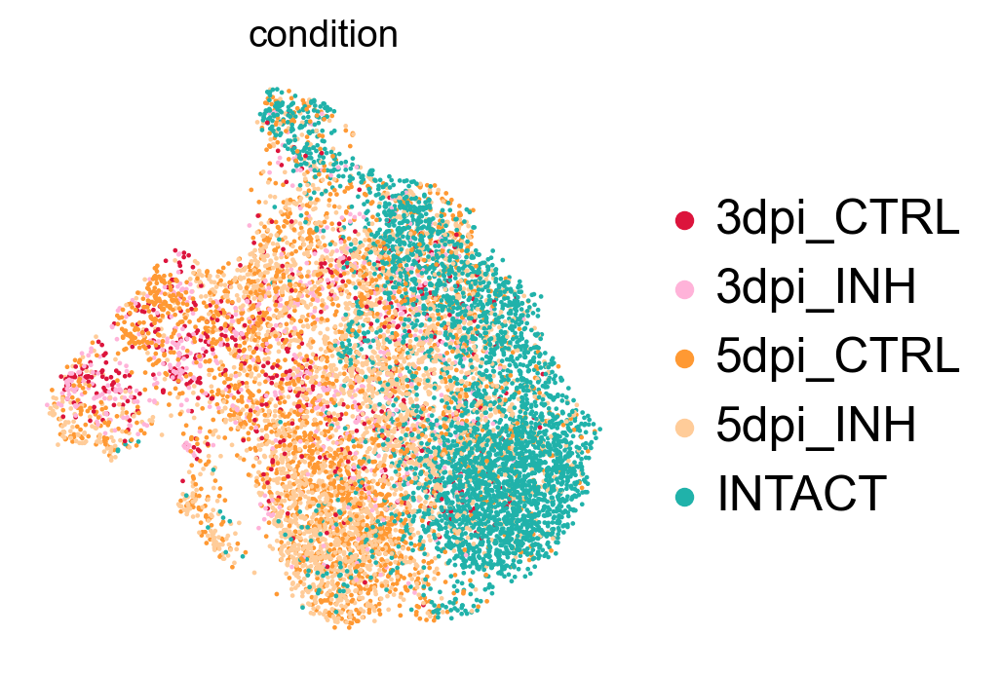

In [91]:
sc.pl.umap(adata_all_micro_proc, color=['condition'], legend_fontsize =float(18),  legend_fontweight= 'normal', frameon= False, save='_3M_conditions.pdf' )

In [147]:
cyclingcell_micro=pd.crosstab(adata_all_micro_proc.obs['cell_cycle'], adata_all_micro_proc.obs['condition'], normalize='columns')

In [148]:
cyclingcell_micro

condition,3dpi_CTRL,3dpi_INH,5dpi_CTRL,5dpi_INH,INTACT
cell_cycle,,,,,
resting,0.828619,0.854342,0.955715,0.991313,0.999169
cycling,0.171381,0.145658,0.044285,0.008687,0.000831


In [92]:
sc.tl.rank_genes_groups(adata_all_micro_proc, groupby='clustersmicro', key_added='rank_genes_clustersmicro', method='t-test_overestim_var', use_raw=True)

ranking genes
    finished: added to `.uns['rank_genes_clustersmicro']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


    using 'X_pca' with n_pcs = 9
Storing dendrogram info using `.uns['dendrogram_clustersmicro']`


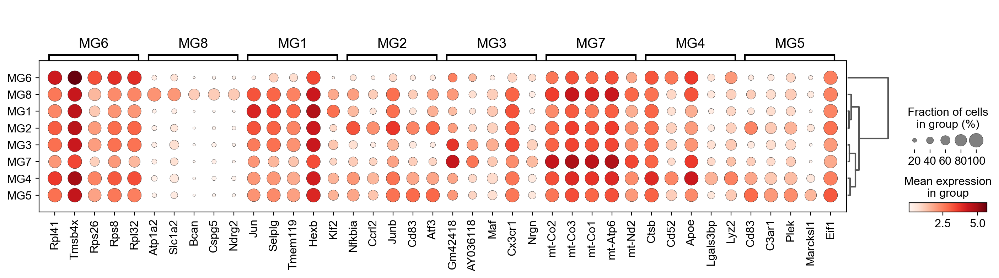

In [93]:
sc.pl.rank_genes_groups_dotplot(adata_all_micro_proc, n_genes=5, key='rank_genes_clustersmicro' )

In [94]:
micro_dpi=adata_all_micro_proc[np.in1d(adata_all_micro_proc.obs['condition'], 
                           ['3dpi_CTRL','3dpi_INH','5dpi_CTRL','5dpi_INH'])].copy()

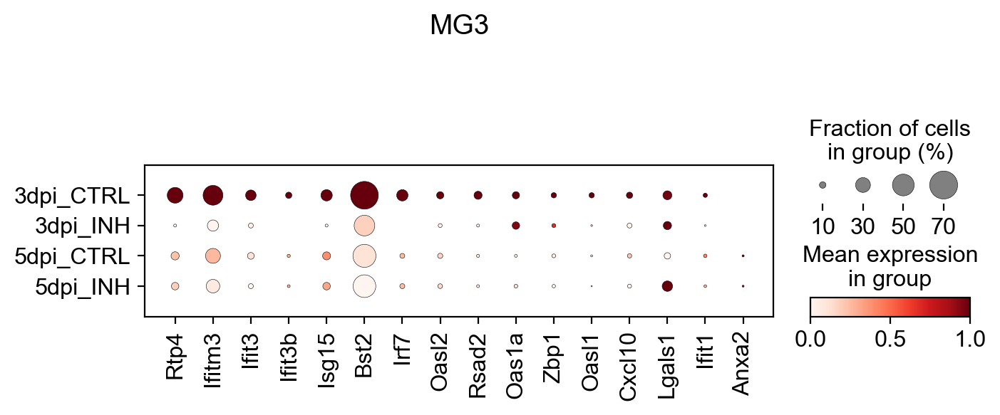

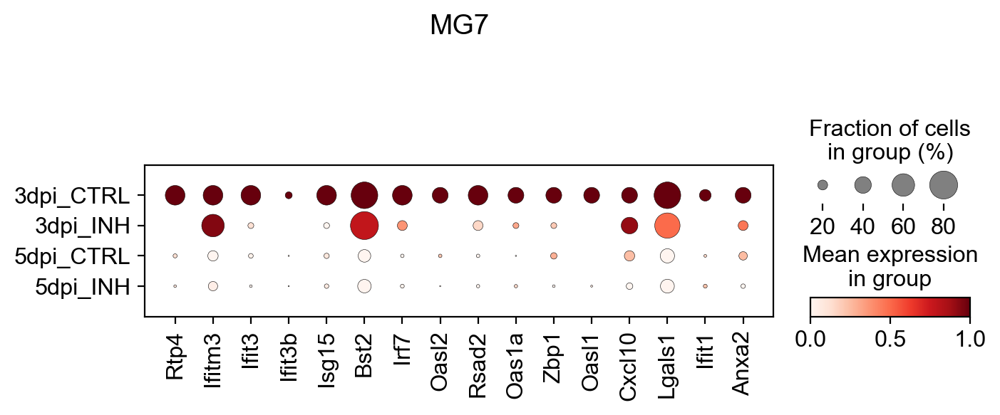

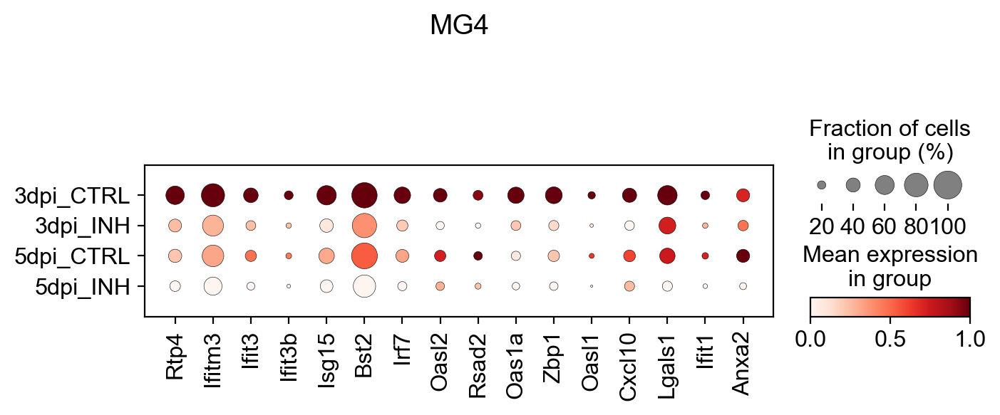

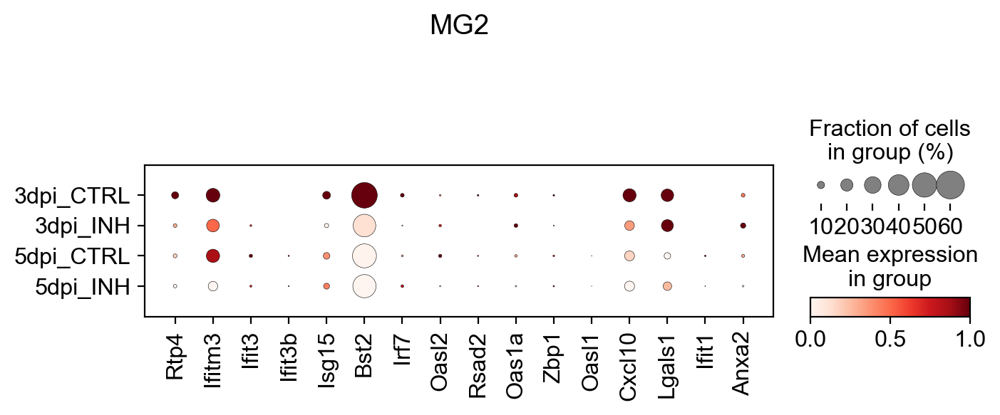

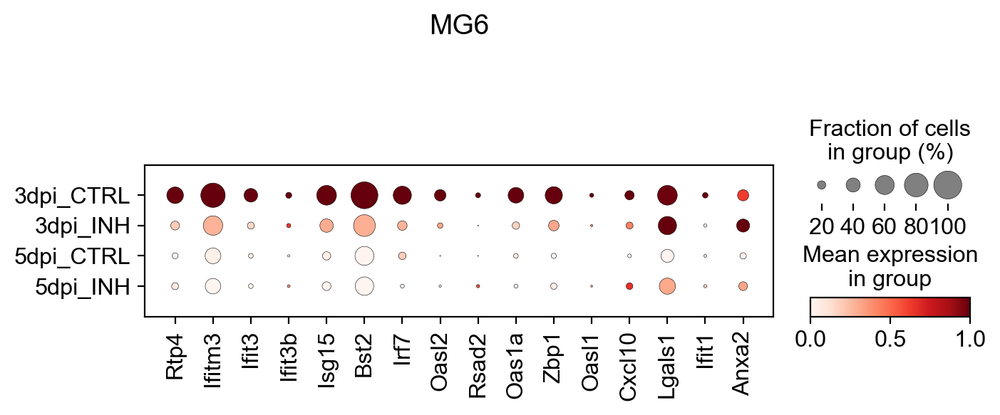

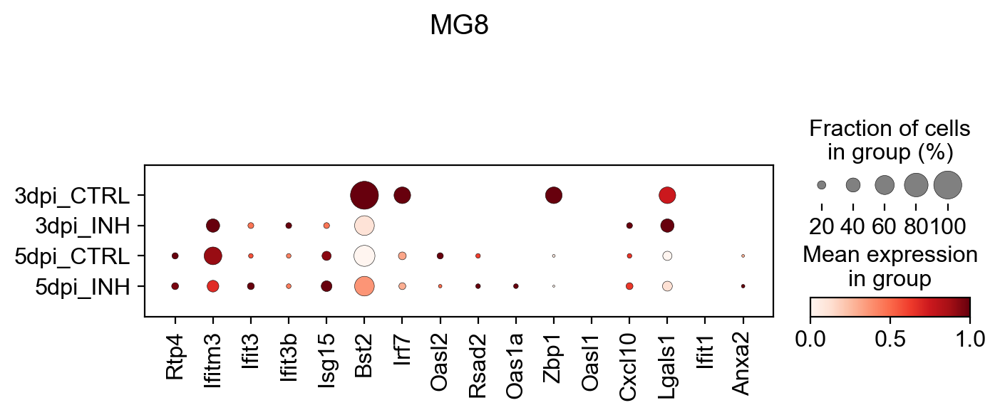

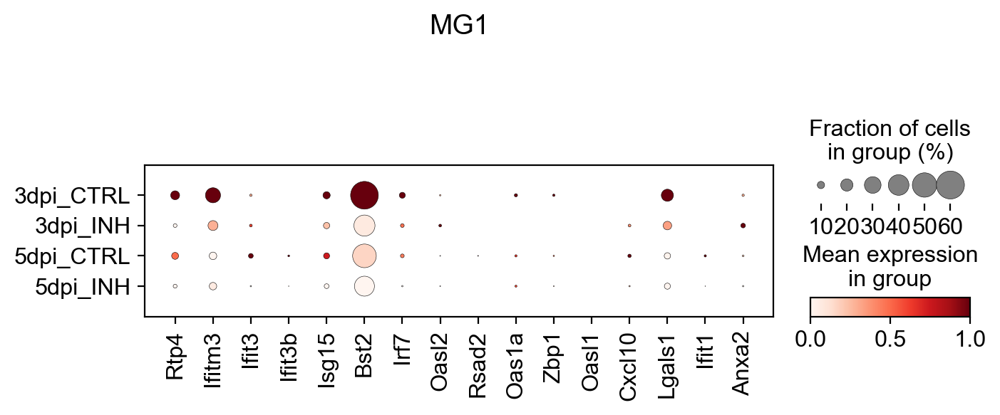

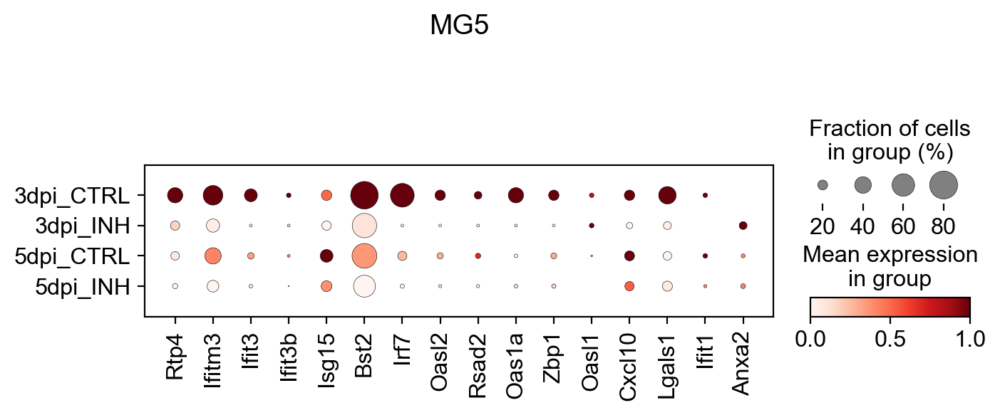

In [95]:
for i in set(micro_dpi.obs['clustersmicro']):
    sc.pl.dotplot(micro_dpi[micro_dpi.obs['clustersmicro']== i ],
              var_names=['Rtp4','Ifitm3','Ifit3','Ifit3b','Isg15','Bst2','Irf7','Oasl2','Rsad2',
                         'Oas1a','Zbp1','Oasl1','Cxcl10','Lgals1', 'Ifit1', 'Anxa2'],standard_scale='var', title=i,
              groupby='condition', save='_infl_genes'+i+'.pdf')

In [96]:
adata_all_micro_proc.obs['condition'].value_counts()

INTACT       3611
5dpi_INH     2878
5dpi_CTRL    2642
3dpi_INH      714
3dpi_CTRL     601
Name: condition, dtype: int64

In [97]:
intact_subsam = sc.pp.subsample(adata_all_micro_proc[adata_all_micro_proc.obs['condition']=='INTACT'],n_obs=601,copy=True).obs_names
five_dpi_I_subsam = sc.pp.subsample(adata_all_micro_proc[adata_all_micro_proc.obs['condition']=='5dpi_INH'],n_obs=601,copy=True).obs_names
five_dpi_V_subsam = sc.pp.subsample(adata_all_micro_proc[adata_all_micro_proc.obs['condition']=='5dpi_CTRL'],n_obs=601,copy=True).obs_names
three_dpi_I_subsam = sc.pp.subsample(adata_all_micro_proc[adata_all_micro_proc.obs['condition']=='3dpi_INH'],n_obs=601,copy=True).obs_names
three_dpi_V_subsam = sc.pp.subsample(adata_all_micro_proc[adata_all_micro_proc.obs['condition']=='3dpi_CTRL'],n_obs=601,copy=True).obs_names
adata_all_micro_proc_subsam = adata_all_micro_proc[list(intact_subsam) + list(five_dpi_I_subsam)+ list(five_dpi_V_subsam)+list(three_dpi_I_subsam)+list(three_dpi_V_subsam)].copy()

In [98]:
sc.tl.embedding_density(adata_all_micro_proc_subsam, basis='umap', groupby='condition')

computing density on 'umap'
--> added
    'umap_density_condition', densities (adata.obs)
    'umap_density_condition_params', parameter (adata.uns)


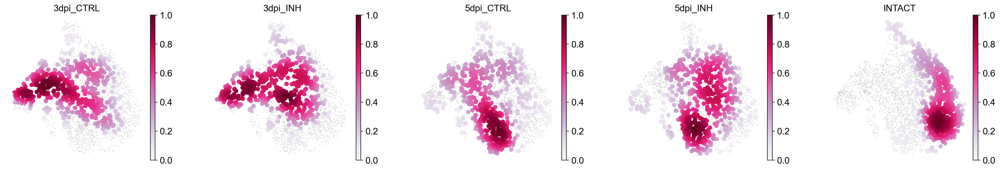

In [99]:
sc.pl.embedding_density(adata_all_micro_proc_subsam, basis='umap',  key='umap_density_condition', color_map='PuRd', wspace=0.3, 
                        bg_dotsize = 8, frameon= False, ncols=5, save='_Micro_distribution_downscaling.pdf')

In [149]:
cyclingcell_micro_s=pd.crosstab(adata_all_micro_proc_subsam.obs['cell_cycle'], adata_all_micro_proc_subsam.obs['condition'], normalize='columns')

In [151]:
cyclingcell_micro_s

condition,3dpi_CTRL,3dpi_INH,5dpi_CTRL,5dpi_INH,INTACT
cell_cycle,,,,,
resting,0.828619,0.85025,0.953411,0.988353,1.0
cycling,0.171381,0.14975,0.046589,0.011647,0.0


In [152]:
cyclingcell_micro_s=cyclingcell_micro_s.T*100

In [153]:
cyclingcell_micro_s

cell_cycle,resting,cycling
condition,,
3dpi_CTRL,82.861897,17.138103
3dpi_INH,85.024958,14.975042
5dpi_CTRL,95.341098,4.658902
5dpi_INH,98.835275,1.164725
INTACT,100.000000,0.000000


In [154]:
cyclingcell_micro_s=cyclingcell_micro_s.reindex(['INTACT','3dpi_CTRL', '3dpi_INH', '5dpi_CTRL', '5dpi_INH'])

In [155]:
fields = ['resting','cycling']
colors = ['#c2c2d6', '#cc0066']
labels = ['resting', 'cycling']

In [156]:
list(cyclingcell_micro_s['cycling'])

[0.0,
 17.13810316139767,
 14.975041597337771,
 4.658901830282862,
 1.1647254575707155]

In [157]:
cyclingcell_micro_s=pd.DataFrame({'Sample': [ 'INTACT','3dpi_CTRL', '3dpi_INH', '5dpi_CTRL', '5dpi_INH',], 
'resting': cyclingcell_micro_s['resting'] ,
'cycling': cyclingcell_micro_s['cycling']})


In [158]:
cyclingcell_micro_s

,Sample,resting,cycling
condition,,,
INTACT,INTACT,100.000000,0.000000
3dpi_CTRL,3dpi_CTRL,82.861897,17.138103
3dpi_INH,3dpi_INH,85.024958,14.975042
5dpi_CTRL,5dpi_CTRL,95.341098,4.658902
5dpi_INH,5dpi_INH,98.835275,1.164725


Text(0, 0.5, 'Cycling cells (%)')

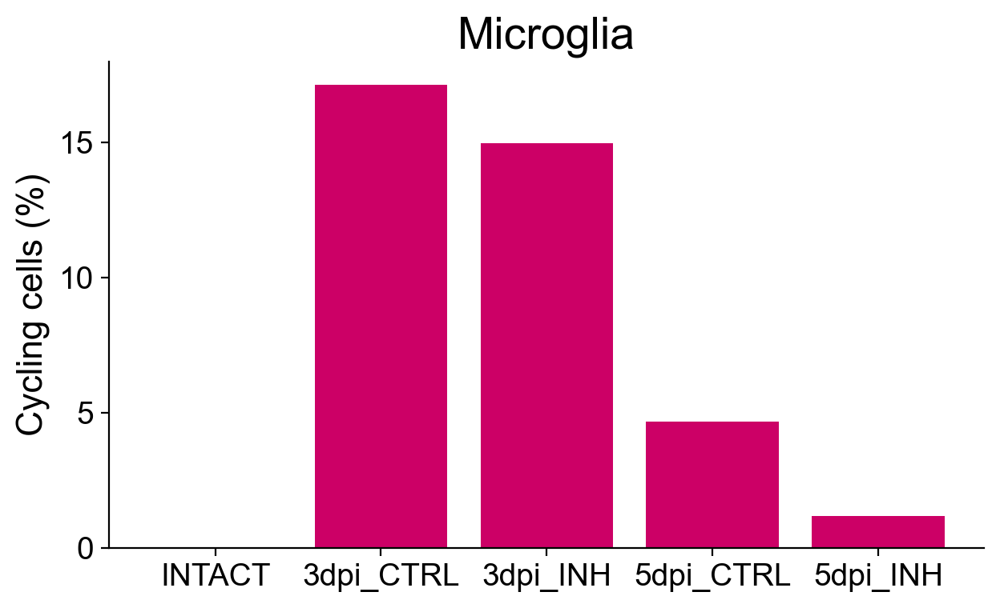

In [159]:
# figure and axis
fig, ax = plt.subplots(1, figsize=(7, 4))
ax.bar(cyclingcell_micro_s['Sample'],cyclingcell_micro_s['cycling'],color='#cc0066',)
plt.title('Microglia', loc='center', fontsize="20")
ax.set_axisbelow(True)
plt.grid(b=None)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(True)
ax.spines['top'].set_visible(False)
ax.spines['bottom'].set_visible(True)
plt.ylabel('Cycling cells (%)', fontsize=16)
#plt.savefig('/Volumes/Seagate_Exp/Paper_sc_analysis/notebooks/analysis_early_time_points/040522_corrected_notebooks/Paper_figures/220713/cyclngcells_astros.pdf', dpi=300)

In [100]:
result = adata_all_micro_proc.uns['rank_genes_clustersmicro']
groups = result['names'].dtype.names
adata_aclmicro_genes = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names','scores', 'pvals','logfoldchanges']})

In [101]:
adata_aclmicro_genes

,MG1_n,MG1_s,MG1_p,MG1_l,MG2_n,MG2_s,MG2_p,MG2_l,MG3_n,MG3_s,...,MG6_p,MG6_l,MG7_n,MG7_s,MG7_p,MG7_l,MG8_n,MG8_s,MG8_p,MG8_l
0,Jun,53.812160,0.0,2.319748,Nfkbia,51.513977,0.000000e+00,2.877231,Gm42418,30.358456,...,1.280424e-114,2.006548,mt-Co2,15.983290,4.264284e-45,2.325215,Atp1a2,26.944719,4.152029e-81,4.569290
1,Selplg,48.013584,0.0,1.437965,Ccrl2,43.580757,0.000000e+00,2.622502,AY036118,30.333887,...,1.385151e-119,1.629206,mt-Co3,14.721745,1.998084e-39,1.986943,Slc1a2,17.323154,6.138543e-47,3.315142
2,Tmem119,44.846653,0.0,1.401977,Junb,43.162182,0.000000e+00,2.044357,Maf,24.531404,...,2.057940e-99,2.240882,mt-Co1,14.663181,2.024789e-39,2.100831,Bcan,14.989811,7.165792e-35,4.321817
3,Hexb,43.792992,0.0,0.869894,Cd83,42.201195,0.000000e+00,2.527636,Cx3cr1,24.245926,...,3.162781e-92,1.711854,mt-Atp6,14.090545,8.994565e-37,1.924393,Cspg5,14.819306,5.470210e-36,3.531446
4,Klf2,42.641735,0.0,2.623274,Atf3,41.971863,0.000000e+00,2.478461,Nrgn,23.911741,...,2.541909e-89,1.749792,mt-Nd2,13.610782,4.555398e-35,2.063594,Ndrg2,14.512816,1.426189e-34,3.642575
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19285,Rps12,-40.967468,0.0,-1.421669,Ctsz,-17.536869,1.453289e-66,-0.519275,Junb,-37.363140,...,9.303848e-117,-4.087375,Rps14,-16.742151,9.421065e-47,-2.209416,Eef1a1,-4.735482,3.385721e-06,-0.471401
19286,Fau,-41.104820,0.0,-0.991130,Mafb,-17.683657,1.324519e-67,-0.944267,H3f3b,-38.171227,...,6.664159e-131,-3.579047,Rps27,-17.075174,3.661944e-49,-2.335895,Fau,-4.751035,3.130847e-06,-0.502394
19287,Rps26,-41.362938,0.0,-1.646180,Rsrp1,-17.902786,3.178382e-69,-0.940839,Ubc,-38.883953,...,1.854963e-150,-3.554203,Tmsb4x,-17.861526,2.173712e-51,-1.805974,Rps13,-4.755690,3.030985e-06,-0.621336
19288,Rpl23,-42.809147,0.0,-1.281544,Ctsb,-18.349915,3.132061e-72,-0.592743,Ftl1,-46.549545,...,1.589145e-143,-5.837627,Rps29,-18.643839,1.757293e-54,-2.218815,Rps8,-4.838361,2.076890e-06,-0.619556


In [102]:
adata_aclmicro_genes.to_csv(table_dir+'/adata_aclmicro_genes.csv')

In [103]:
adata_all_micro_proc.write(data_dir+today + "adata_treated_micro_proc_scVI.h5ad")

# Oligodendrocytes

### Read Data & downstream analysis

In [104]:
adata_all_oligos_proc = sc.read(data_dir + '230807adata_all_oligos_treated_scVI.h5ad')

In [105]:
#Filter genes:
print('Total number of genes: {:d}'.format(adata_all_oligos_proc.n_vars))

# Min 20 cells - filters out 0 count genes
sc.pp.filter_genes(adata_all_oligos_proc, min_cells=20)
print('Number of genes after cell filter: {:d}'.format(adata_all_oligos_proc.n_vars))

Total number of genes: 19290
filtered out 5040 genes that are detected in less than 20 cells
Number of genes after cell filter: 14250


In [106]:
# use scVI latent space for UMAP generation
sc.pp.neighbors(adata_all_oligos_proc, use_rep="X_scVI", n_neighbors=30)


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


In [107]:
sc.tl.umap(adata_all_oligos_proc, random_state=3)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:06)


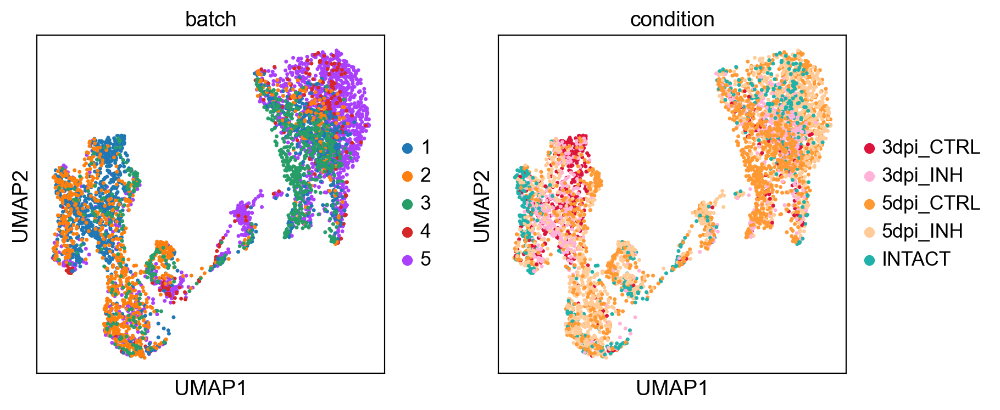

In [108]:
sc.pl.umap(adata_all_oligos_proc, color=['batch','condition'])

In [109]:
sc.tl.leiden(adata_all_oligos_proc, key_added='leiden_oligos_r1')
sc.tl.leiden(adata_all_oligos_proc, resolution=0.5, key_added='leiden_oligos_r0.5')
sc.tl.leiden(adata_all_oligos_proc, resolution=0.8, key_added='leiden_oligos_r0.8')

running Leiden clustering
    finished: found 13 clusters and added
    'leiden_oligos_r1', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 8 clusters and added
    'leiden_oligos_r0.5', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 11 clusters and added
    'leiden_oligos_r0.8', the cluster labels (adata.obs, categorical) (0:00:00)


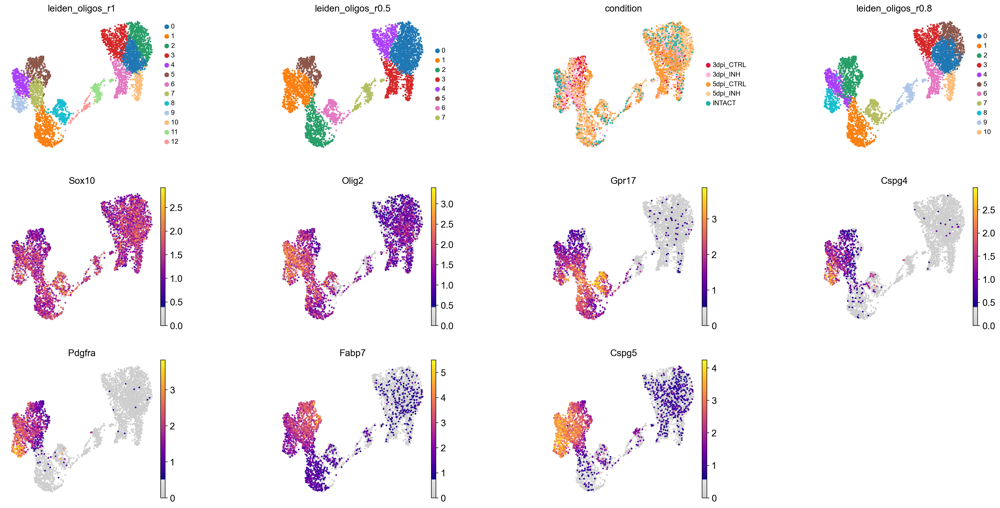

In [110]:
sc.pl.umap(adata_all_oligos_proc, color=['leiden_oligos_r1','leiden_oligos_r0.5','condition', 'leiden_oligos_r0.8' ,'Sox10', 'Olig2','Gpr17','Cspg4','Pdgfra', 'Fabp7','Cspg5'], legend_fontsize =float(10),
           wspace=0.6, legend_fontweight= 'normal', frameon= False,cmap=mymap2  )

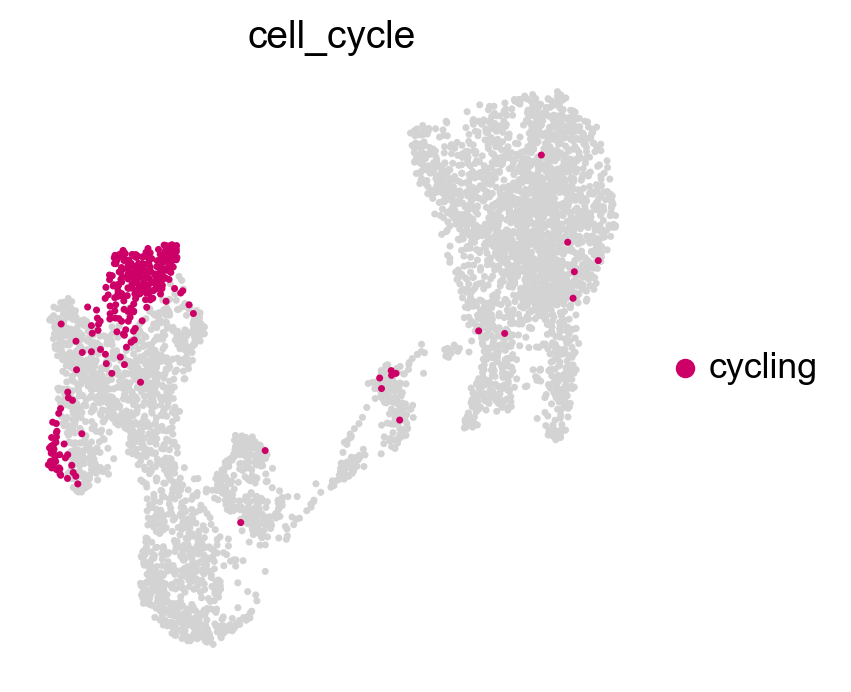

In [111]:
sc.pl.umap(adata_all_oligos_proc, color=['cell_cycle'], groups=['cycling'], na_in_legend=False, cmap=mymap2, frameon= False )#, )#save='_oligos_g2m_all.pdf')

In [112]:
print(adata_all_oligos_proc.obs['condition'].value_counts())

5dpi_CTRL    1620
5dpi_INH     1452
3dpi_INH      651
INTACT        555
3dpi_CTRL     430
Name: condition, dtype: int64


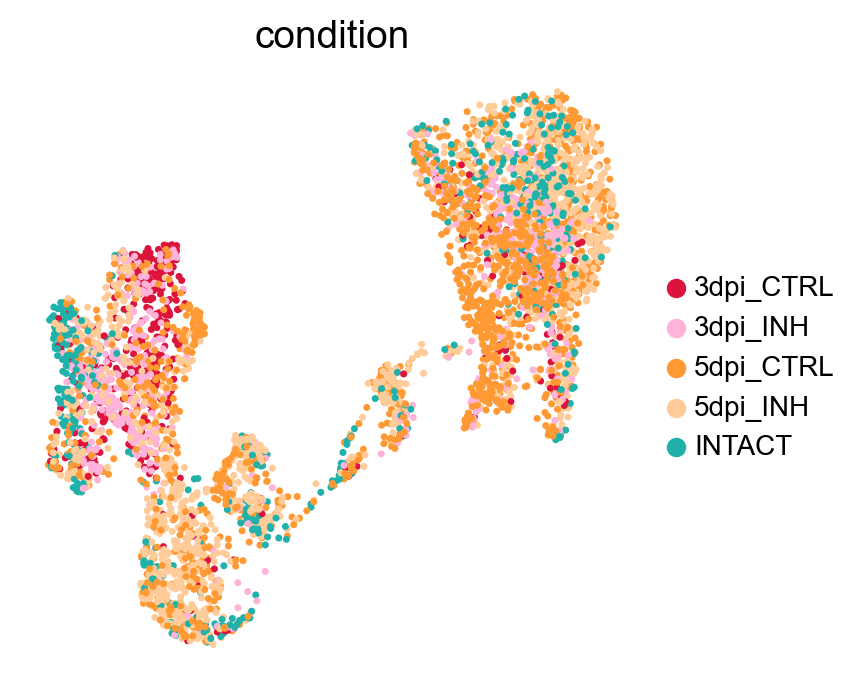

In [113]:
sc.pl.umap(adata_all_oligos_proc, color=['condition'], legend_fontsize =float(10), legend_fontweight= 'normal',  frameon= False,  )

In [114]:
sc.tl.rank_genes_groups(adata_all_oligos_proc, groupby='leiden_oligos_r0.8', key_added='rank_genes_oligos_r0.8', method='t-test_overestim_var', use_raw=True)

ranking genes
    finished: added to `.uns['rank_genes_oligos_r0.8']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


In [115]:
sc.tl.dendrogram(adata_all_oligos_proc, groupby='leiden_oligos_r0.8',)

    using 'X_pca' with n_pcs = 9
Storing dendrogram info using `.uns['dendrogram_leiden_oligos_r0.8']`


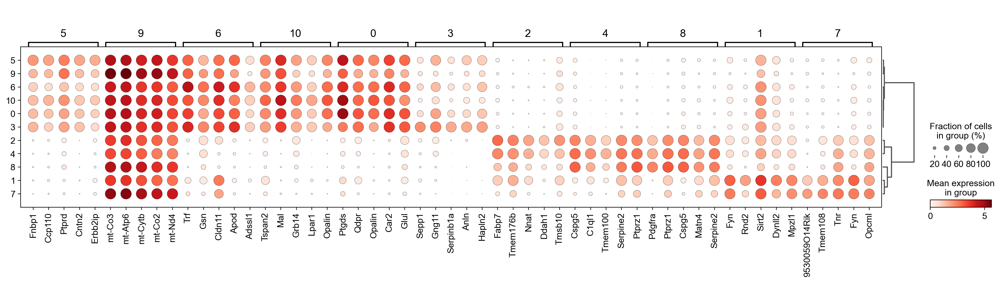

In [116]:
sc.pl.rank_genes_groups_dotplot(adata_all_oligos_proc, n_genes=5, key='rank_genes_oligos_r0.8', cmap='Reds')

In [117]:
OPCs=('Pdgfra', 'C1ql1','Sapcd2','Emid1')
COPs=('Neu4', 'Brca1', 'Gpr17', 'Pak4','Lims2')
NFOL=('Cnksr3', 'H2-Ab1','Cnksr3','Rras2','Tmem2','Il23a','Tmem163')
MFOL=('2210011C24Rik', 'Wfdc18', 'Tmem141','Opalin','Birc2','Fam214a')
MOL=('Opalin', 'Ninj2',)

In [118]:
sc.tl.score_genes(adata_all_oligos_proc, OPCs, score_name='OPCs' )
sc.tl.score_genes(adata_all_oligos_proc, COPs, score_name='COPs' )
sc.tl.score_genes(adata_all_oligos_proc, NFOL, score_name='NFOL' )
sc.tl.score_genes(adata_all_oligos_proc, MFOL, score_name='MFOL' )
sc.tl.score_genes(adata_all_oligos_proc, MOL, score_name='MOL' )

computing score 'OPCs'
    finished: added
    'OPCs', score of gene set (adata.obs).
    200 total control genes are used. (0:00:00)
computing score 'COPs'
    finished: added
    'COPs', score of gene set (adata.obs).
    200 total control genes are used. (0:00:00)
computing score 'NFOL'
    finished: added
    'NFOL', score of gene set (adata.obs).
    249 total control genes are used. (0:00:00)
computing score 'MFOL'
    finished: added
    'MFOL', score of gene set (adata.obs).
    299 total control genes are used. (0:00:00)
computing score 'MOL'
    finished: added
    'MOL', score of gene set (adata.obs).
    99 total control genes are used. (0:00:00)


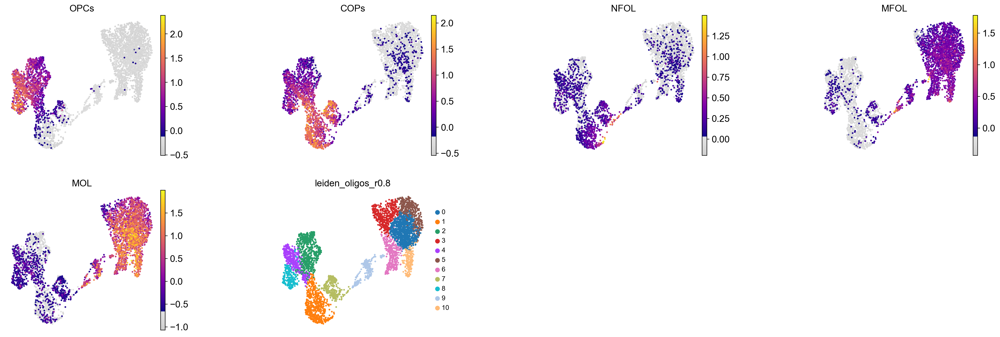

In [119]:
sc.pl.umap(adata_all_oligos_proc, color=[ 'OPCs','COPs','NFOL','MFOL','MOL','leiden_oligos_r0.8'  ], legend_fontsize =float(10), wspace=0.6, legend_fontweight= 'normal', frameon= False,cmap=mymap2  )

In [120]:
cluster2annotation = {
    '0': 'MOL1',
    '1': 'COPs1',
    '2': 'OPCs2',
    '3': 'MOL2',
    '4': 'OPCs1',
    '5': 'MOL3',
    '6': 'MOL4',
    '7': 'COPs2',
    '8': 'OPCs3',
    '9': 'MFOL',
    '10': 'MOL5'
    }

In [121]:
clustersOt= [ '#b3b3ff', '#bdcbf5', '#ff6666', '#6666ff', '#4169e1', '#5d7ebb', '#92a8d1', '#b3d9ff', '#4da6ff', '#c299ff', '#ba55d3', '#666699']

In [122]:
adata_all_oligos_proc.obs['clustersoligos'] = adata_all_oligos_proc.obs['leiden_oligos_r0.8'].map(cluster2annotation).astype('category')

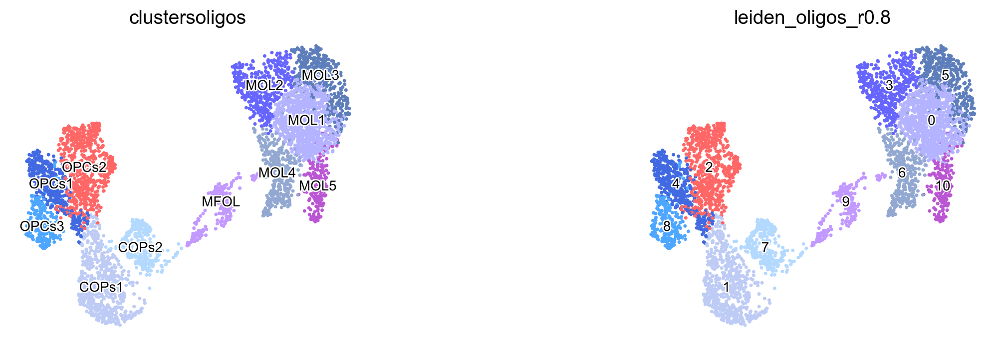

In [123]:
sc.pl.umap(adata_all_oligos_proc, color=[ 'clustersoligos', 'leiden_oligos_r0.8' ], legend_fontsize =float(10),palette=clustersOt,legend_loc='on data',legend_fontoutline=2,
           wspace=0.6, legend_fontweight= 'normal', frameon= False,cmap=mymap2  )

In [124]:
sc.tl.rank_genes_groups(adata_all_oligos_proc, groupby='clustersoligos', key_added='rank_genes_clustersoligos', method='t-test_overestim_var', use_raw=True)

ranking genes
    finished: added to `.uns['rank_genes_clustersoligos']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


    using 'X_pca' with n_pcs = 9
Storing dendrogram info using `.uns['dendrogram_clustersoligos']`


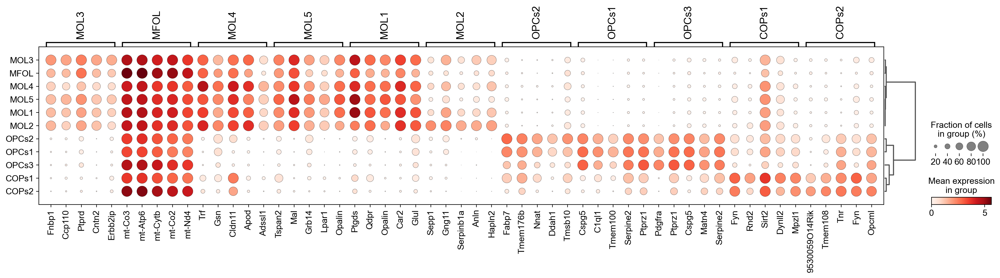

In [125]:
sc.pl.rank_genes_groups_dotplot(adata_all_oligos_proc, n_genes=5, key='rank_genes_clustersoligos', cmap='Reds')

## Plots for figures

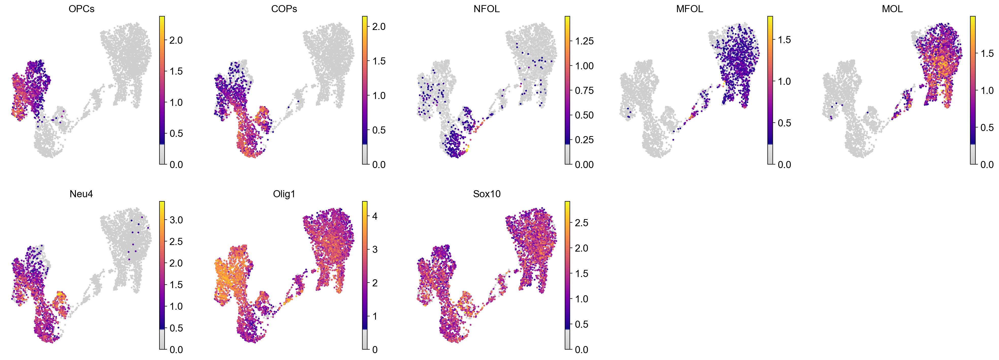

In [126]:
sc.pl.umap(adata_all_oligos_proc, color=('OPCs', 'COPs', 'NFOL', 'MFOL', 'MOL','Neu4', 'Olig1','Sox10'),vmin=0, ncols=5,frameon= False,cmap=mymap2 )

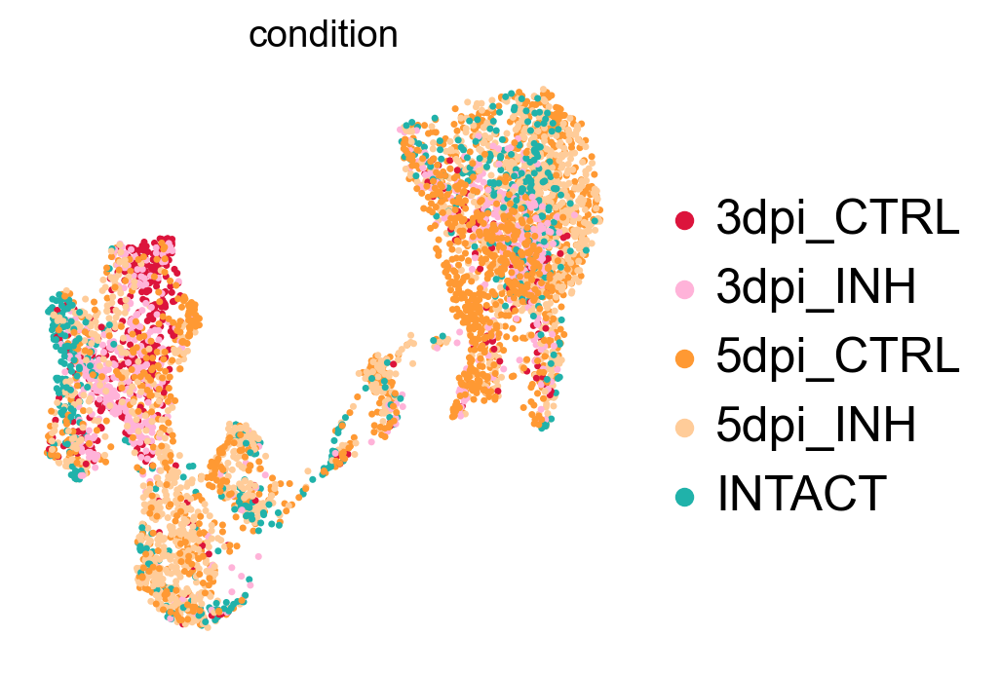

In [127]:
sc.pl.umap(adata_all_oligos_proc, color=['condition'], legend_fontsize =float(18),  
           legend_fontweight= 'normal',  frameon= False,save='_3O_condition.pdf' )

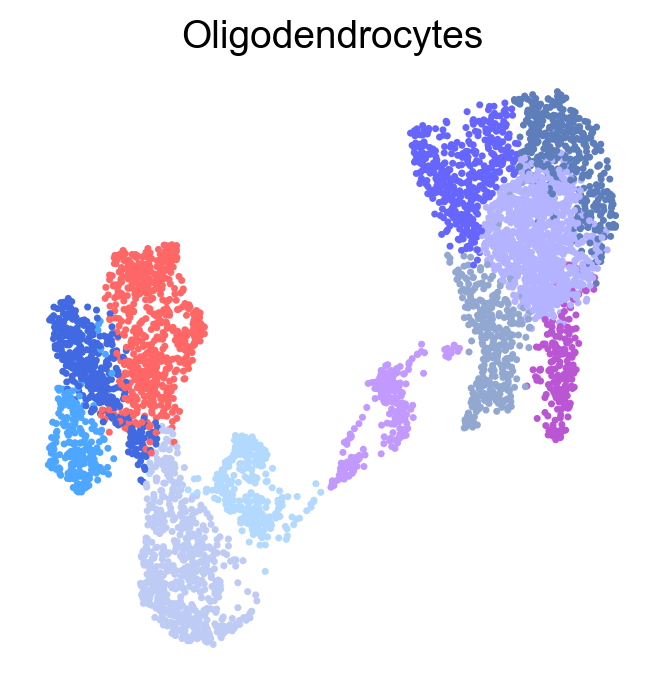

In [128]:
sc.pl.umap(adata_all_oligos_proc, color=['clustersoligos'], legend_fontsize =float(16),title='Oligodendrocytes',legend_fontoutline=2,legend_loc='',
           wspace=0.6, legend_fontweight= 'black', frameon= False,save='_1O_clusters.pdf'  )

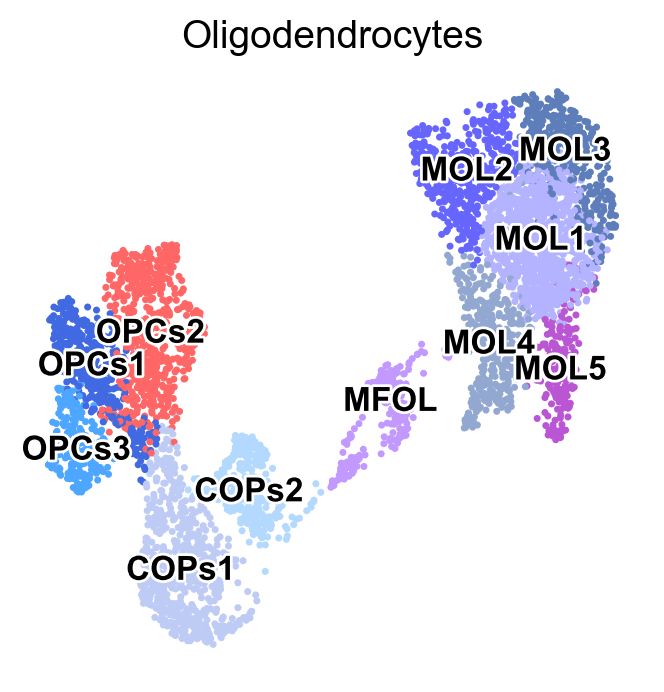

In [129]:
sc.pl.umap(adata_all_oligos_proc, color=['clustersoligos'],title='Oligodendrocytes', legend_fontsize =float(12),legend_fontoutline=2,legend_loc='on data',
           wspace=0.6, legend_fontweight= 'black', frameon= False, save='_1O_clusterslabels.pdf' )

In [130]:
oligos_dpi=adata_all_oligos_proc[np.in1d(adata_all_oligos_proc.obs['condition'], 
                           ['3dpi_CTRL','3dpi_INH','5dpi_CTRL','5dpi_INH'])].copy()

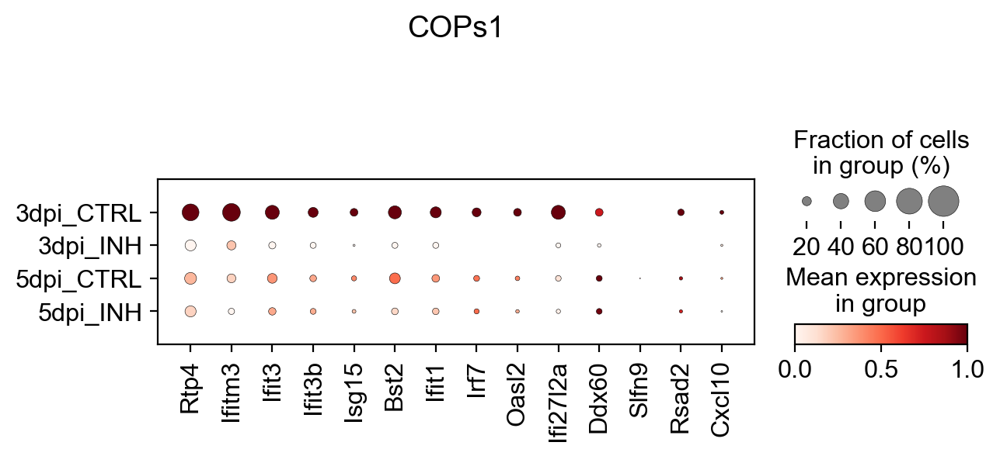

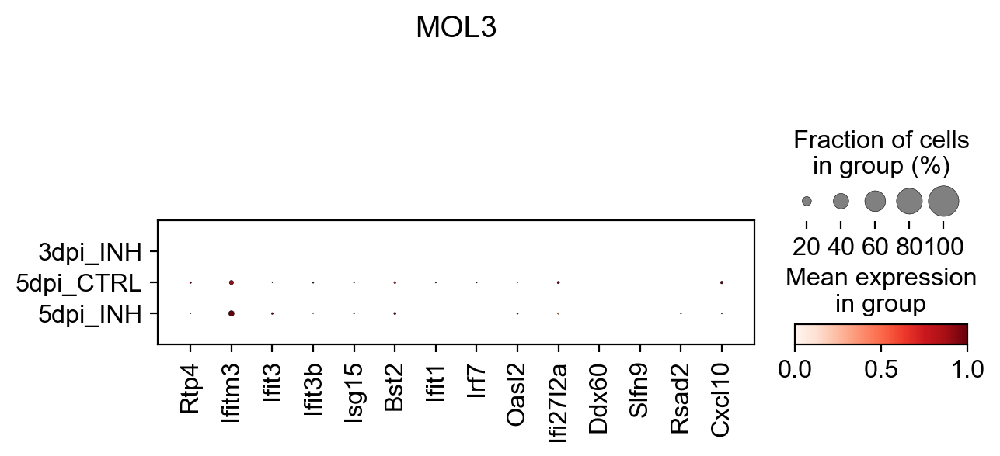

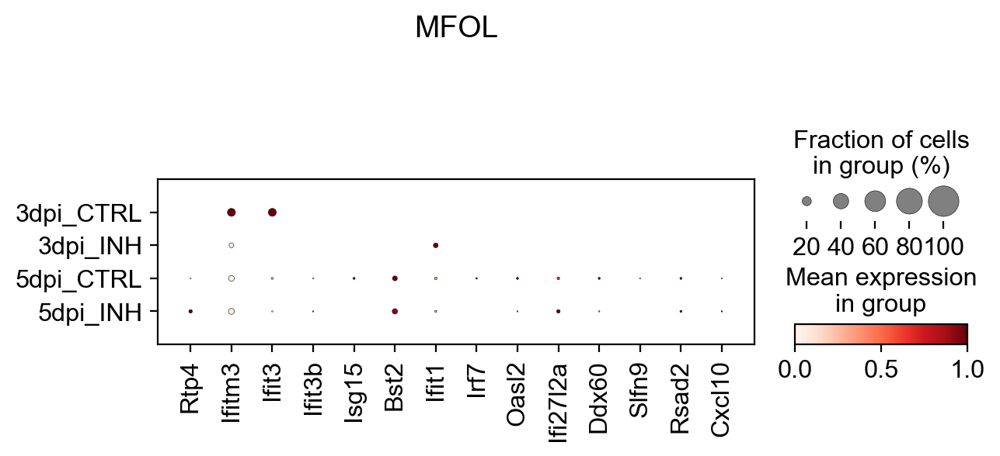

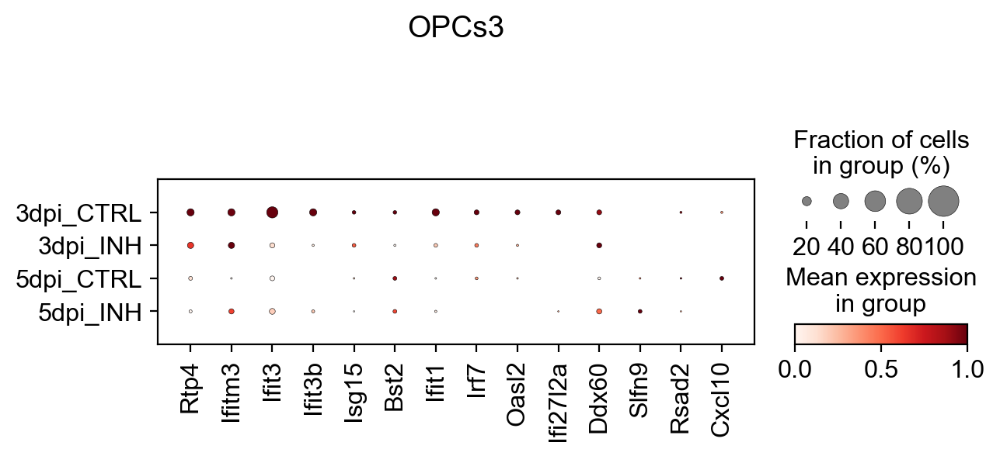

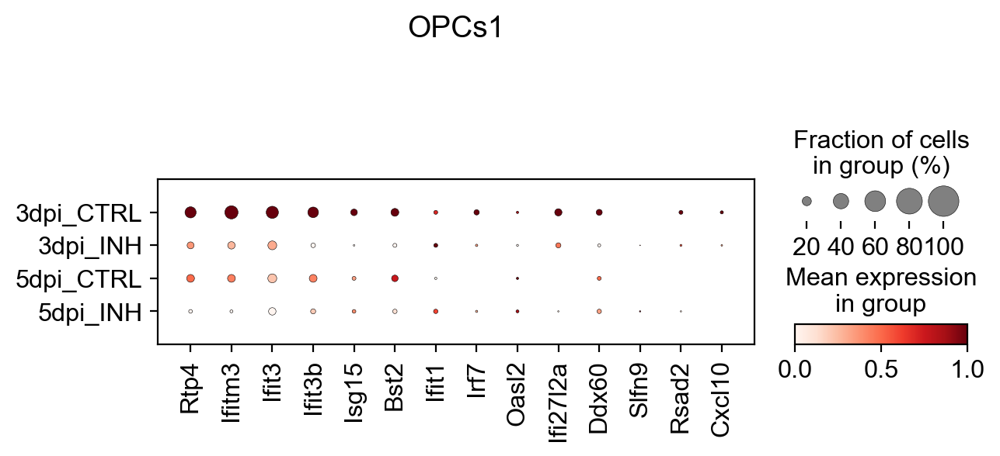

...

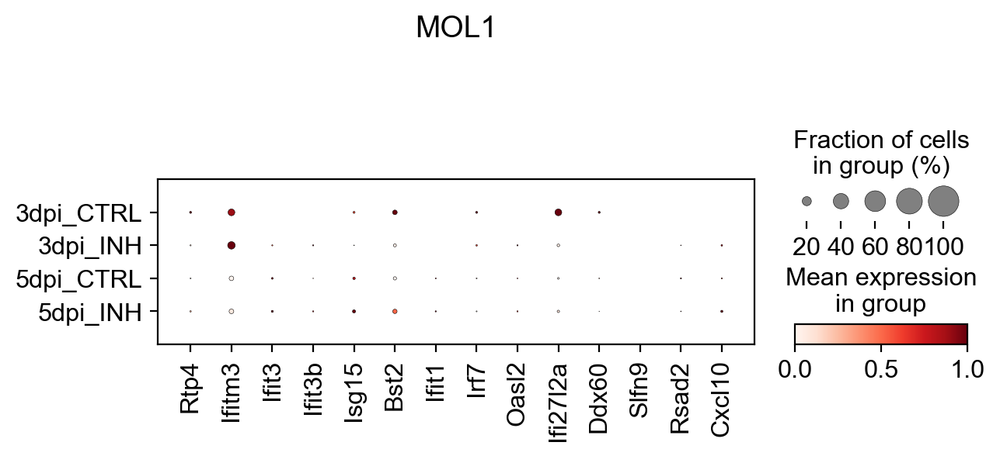

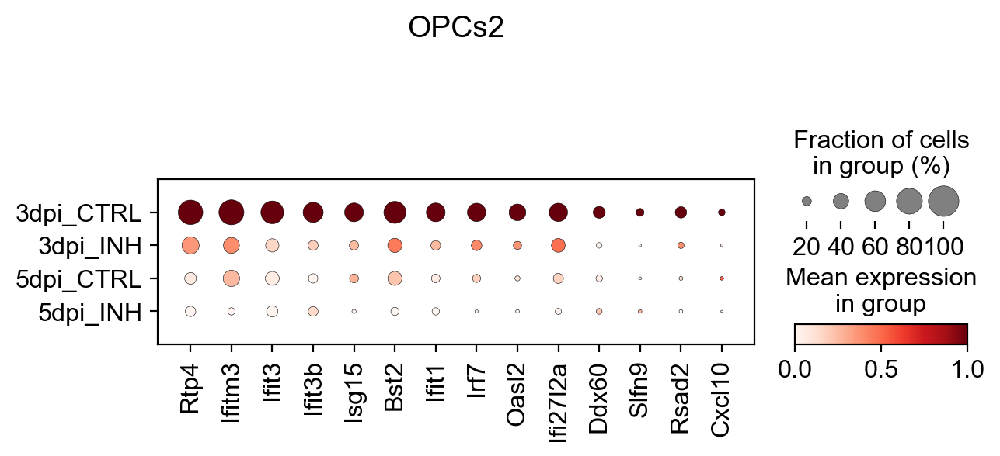

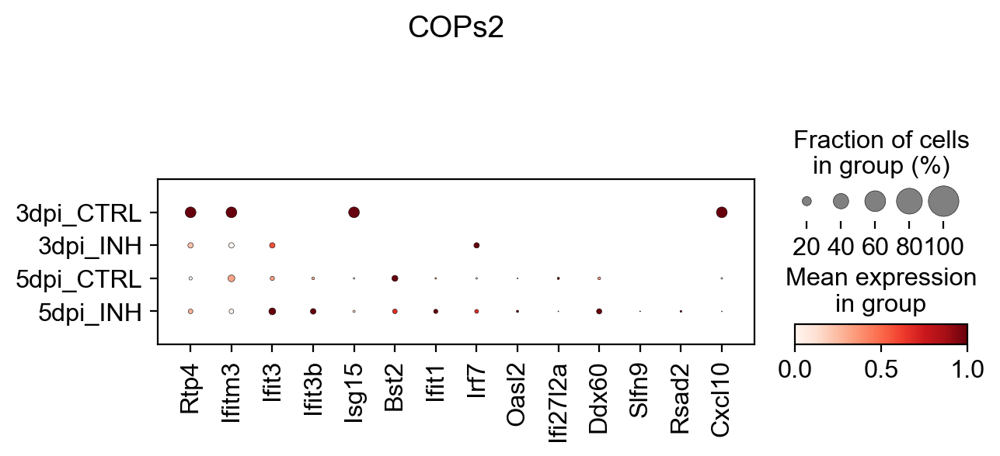

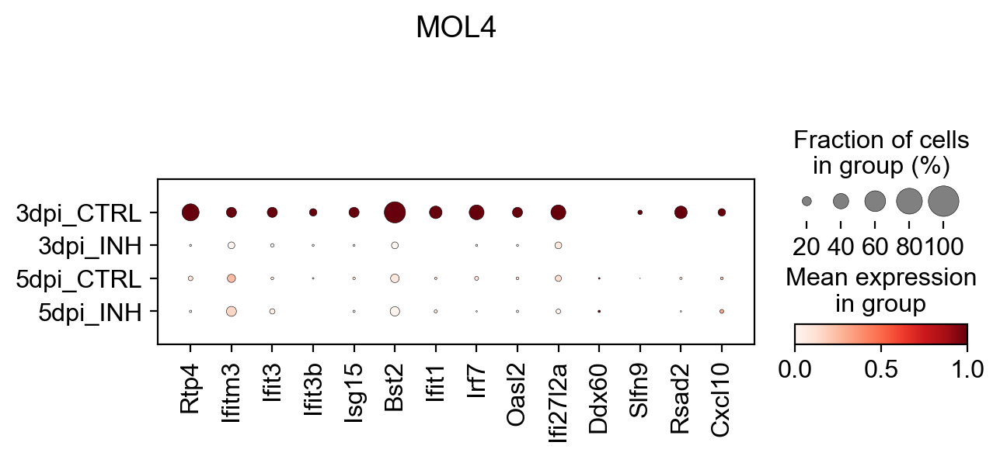

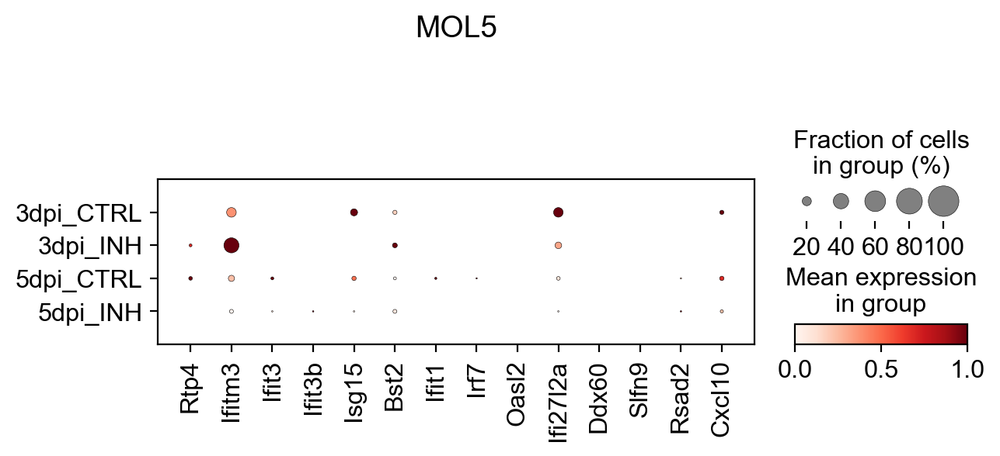

In [131]:
for i in set(oligos_dpi.obs['clustersoligos']):
    sc.pl.dotplot(oligos_dpi[oligos_dpi.obs['clustersoligos']== i],dot_max=1,
              var_names=['Rtp4','Ifitm3','Ifit3','Ifit3b','Isg15','Bst2','Ifit1','Irf7','Oasl2','Ifi27l2a','Ddx60','Slfn9','Rsad2','Cxcl10'], standard_scale='var',
              groupby='condition', title=i, save='_infl_genes_'+i+'.pdf')

In [132]:
adata_all_oligos_proc.obs['condition'].value_counts()

5dpi_CTRL    1620
5dpi_INH     1452
3dpi_INH      651
INTACT        555
3dpi_CTRL     430
Name: condition, dtype: int64

In [133]:
intact_subsam = sc.pp.subsample(adata_all_oligos_proc[adata_all_oligos_proc.obs['condition']=='INTACT'],n_obs=430,copy=True).obs_names
five_dpi_I_subsam = sc.pp.subsample(adata_all_oligos_proc[adata_all_oligos_proc.obs['condition']=='5dpi_INH'],n_obs=430,copy=True).obs_names
five_dpi_V_subsam = sc.pp.subsample(adata_all_oligos_proc[adata_all_oligos_proc.obs['condition']=='5dpi_CTRL'],n_obs=430,copy=True).obs_names
three_dpi_I_subsam = sc.pp.subsample(adata_all_oligos_proc[adata_all_oligos_proc.obs['condition']=='3dpi_INH'],n_obs=430,copy=True).obs_names
three_dpi_V_subsam = sc.pp.subsample(adata_all_oligos_proc[adata_all_oligos_proc.obs['condition']=='3dpi_CTRL'],n_obs=430,copy=True).obs_names
adata_all_oligos_proc_subsam = adata_all_oligos_proc[list(intact_subsam) + list(five_dpi_I_subsam)+ list(five_dpi_V_subsam)+list(three_dpi_I_subsam)+list(three_dpi_V_subsam)].copy()

In [134]:
sc.tl.embedding_density(adata_all_oligos_proc_subsam, basis='umap', groupby='condition')

computing density on 'umap'
--> added
    'umap_density_condition', densities (adata.obs)
    'umap_density_condition_params', parameter (adata.uns)


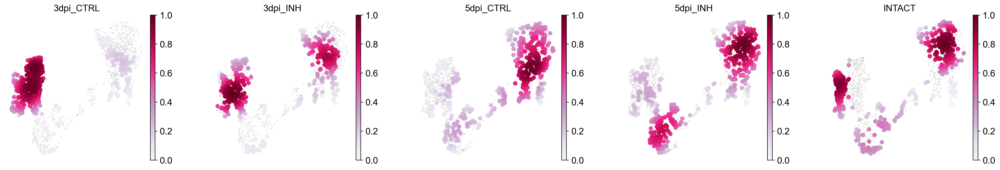

In [135]:
sc.pl.embedding_density(adata_all_oligos_proc_subsam, basis='umap',  key='umap_density_condition', color_map='PuRd',
                        wspace=0.3, bg_dotsize = 8, frameon= False, ncols=5, save='_Oligos_distribution_downscaling.pdf')

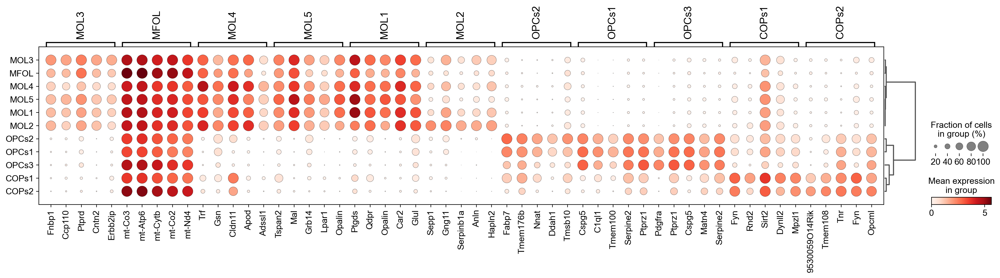

In [136]:
sc.pl.rank_genes_groups_dotplot(adata_all_oligos_proc, n_genes=5, key='rank_genes_clustersoligos', cmap='Reds',save='rank_oligos.pdf')

In [137]:
result = adata_all_oligos_proc.uns['rank_genes_clustersoligos']
groups = result['names'].dtype.names
adata_cloligos_genes = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names','scores', 'pvals','logfoldchanges']})

In [138]:
adata_cloligos_genes

,MOL1_n,MOL1_s,MOL1_p,MOL1_l,COPs1_n,COPs1_s,COPs1_p,COPs1_l,OPCs2_n,OPCs2_s,...,OPCs3_p,OPCs3_l,MFOL_n,MFOL_s,MFOL_p,MFOL_l,MOL5_n,MOL5_s,MOL5_p,MOL5_l
0,Ptgds,47.645847,3.491988e-288,4.902247,Fyn,63.165707,0.000000e+00,4.612242,Fabp7,47.903923,...,1.033294e-110,4.580740,mt-Co3,20.848555,4.576848e-67,1.977434,Tspan2,18.532944,3.010670e-47,2.610508
1,Qdpr,43.795883,8.363944e-250,3.078791,Rnd2,46.823059,6.852294e-261,4.076612,Tmem176b,38.250835,...,5.129766e-98,4.114842,mt-Atp6,20.703808,7.293603e-67,1.941485,Mal,18.343903,1.327973e-44,3.897696
2,Opalin,40.206070,1.261529e-233,3.122473,Sirt2,46.713638,1.789087e-263,2.909183,Nnat,37.414169,...,1.353023e-88,4.034975,mt-Cytb,20.299822,6.991380e-65,1.866015,Grb14,18.097698,3.677492e-47,2.493287
3,Car2,39.714348,3.042071e-220,3.652025,Dynll2,43.006523,1.507078e-244,3.253730,Ddah1,37.053047,...,2.910063e-63,3.174447,mt-Co2,20.208103,8.668763e-64,2.201297,Lpar1,17.973989,7.997271e-51,2.563271
4,Glul,39.554482,3.484171e-231,2.894372,Mpzl1,41.800785,1.982310e-235,3.806113,Tmsb10,36.612617,...,7.133769e-54,3.083920,mt-Nd4,19.905058,5.134972e-63,1.921932,Opalin,17.856508,5.153835e-45,3.084264
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19285,Scrg1,-27.582424,1.641301e-127,-4.793374,Ermn,-29.760204,1.282848e-120,-8.042289,Sept4,-34.477459,...,7.150517e-67,-4.336777,S100a13,-13.584064,7.571833e-35,-2.730073,Rtn1,-10.768307,5.413921e-23,-1.923655
19286,Bcan,-27.744921,5.208942e-130,-4.218655,Car2,-30.213594,3.949005e-123,-7.387283,Aplp1,-37.781399,...,7.275788e-62,-6.148850,Tuba1a,-13.959100,5.869833e-37,-2.349240,Serpine2,-10.773250,1.926120e-21,-4.917363
19287,Tmem176b,-28.276972,6.817098e-132,-5.041065,Mal,-30.657343,1.599978e-125,-7.868279,Plp1,-40.349365,...,1.793785e-66,-5.441751,S100a16,-14.110783,1.302389e-37,-2.365022,S100b,-10.784261,3.718674e-22,-3.033394
19288,Tnr,-28.833790,1.213703e-135,-5.163973,Stmn1,-33.196167,7.257182e-152,-3.609356,Mag,-42.278896,...,3.782930e-81,-4.272800,Btf3,-14.682954,5.269950e-40,-2.345692,Bcan,-10.877216,8.266214e-22,-4.847473


In [139]:
adata_cloligos_genes.to_csv(table_dir+'adata_cloligos_genes.csv')

In [140]:
adata_all_oligos_proc.write(data_dir+today + "adata_treated_oligos_proc_scVI.h5ad")